# Les packages

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import seaborn as sns
import missingno as msno
import gc

pd.options.display.max_rows = 999
import warnings
warnings.filterwarnings('ignore')
#pd.options.display.max_column = 130

# Importation des données

In [2]:
train_data = pd.read_csv("application_train.csv")
test_data = pd.read_csv("application_test.csv")
bureau = pd.read_csv("bureau.csv")
bureau_balance = pd.read_csv("bureau_balance.csv")
card_balance = pd.read_csv("credit_card_balance.csv")
payement = pd.read_csv("installments_payments.csv")
cash_balance = pd.read_csv("POS_CASH_balance.csv")
#home_credit = pd.read_csv("HomeCredit_columns_description.csv")
previous = pd.read_csv("previous_application.csv")
submission = pd.read_csv("sample_submission.csv")

## Affichage et lecture des données

In [3]:
HomeCredit=pd.read_csv('HomeCredit_columns_description.csv',encoding= 'unicode_escape')

In [4]:
pd.set_option('display.max_row',220)
HomeCredit[['Row','Description']]

,Row,Description
0,SK_ID_CURR,ID of loan in our sample
1,TARGET,Target variable (1 - client with payment diffi...
2,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving
3,CODE_GENDER,Gender of the client
4,FLAG_OWN_CAR,Flag if the client owns a car
5,FLAG_OWN_REALTY,Flag if client owns a house or flat
6,CNT_CHILDREN,Number of children the client has
7,AMT_INCOME_TOTAL,Income of the client
8,AMT_CREDIT,Credit amount of the loan
9,AMT_ANNUITY,Loan annuity


In [5]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",17)
bureau.head(5)

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


In [6]:
bureau.shape

(1716428, 17)

In [7]:
bureau = pd.read_csv("bureau.csv").sort_values(['SK_ID_CURR', 'SK_ID_BUREAU'])
bureau

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
248484,100001,5896630,Closed,currency 1,-857,0,-492.0,-553.0,NaN,0,112500.0,0.00,0.0,0.0,Consumer credit,-155,0.0
248485,100001,5896631,Closed,currency 1,-909,0,-179.0,-877.0,NaN,0,279720.0,0.00,0.0,0.0,Consumer credit,-155,0.0
248486,100001,5896632,Closed,currency 1,-879,0,-514.0,-544.0,NaN,0,91620.0,0.00,0.0,0.0,Consumer credit,-155,0.0
248487,100001,5896633,Closed,currency 1,-1572,0,-1329.0,-1328.0,NaN,0,85500.0,0.00,0.0,0.0,Consumer credit,-155,0.0
248488,100001,5896634,Active,currency 1,-559,0,902.0,NaN,NaN,0,337680.0,113166.00,0.0,0.0,Consumer credit,-6,4630.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1010009,456255,5126333,Active,currency 1,-363,0,1463.0,NaN,0.000,0,436032.0,363573.54,0.0,0.0,Consumer credit,-25,0.0
1010010,456255,5126334,Active,currency 1,-451,0,279.0,NaN,15439.905,0,450000.0,191005.47,0.0,0.0,Consumer credit,-55,3244.5
1010011,456255,5126335,Closed,currency 1,-1512,0,315.0,-781.0,25578.000,0,900000.0,NaN,NaN,0.0,Consumer credit,-781,0.0
1010012,456255,5126336,Closed,currency 1,-2337,0,8620.0,-779.0,2646.000,1,38925.0,NaN,NaN,0.0,Credit card,-779,3244.5


In [8]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",3)
bureau_balance.head(5)

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [9]:
bureau_balance.shape

(27299925, 3)

In [10]:
bureau_balance['MONTHS_BALANCE'].describe()

count    2.729992e+07
mean    -3.074169e+01
std      2.386451e+01
min     -9.600000e+01
25%     -4.600000e+01
50%     -2.500000e+01
75%     -1.100000e+01
max      0.000000e+00
Name: MONTHS_BALANCE, dtype: float64

In [11]:
bureau_balance = pd.read_csv("bureau_balance.csv").sort_values("SK_ID_BUREAU")
bureau_balance

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
26079760,5001709,-7,C
26079756,5001709,-3,C
26079757,5001709,-4,C
26079758,5001709,-5,C
26079759,5001709,-6,C
...,...,...,...
23544029,6842888,-26,C
23544030,6842888,-27,C
23544032,6842888,-29,C
23544017,6842888,-14,C


In [12]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",23)
card_balance.head(5)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.0,1800.0,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.0,2250.0,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.0,2250.0,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.0,11925.0,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.0,27000.0,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


In [13]:
card_balance.shape

(3840312, 23)

In [14]:
card_balance = pd.read_csv('credit_card_balance.csv').sort_values(['SK_ID_CURR', 'SK_ID_PREV'])
card_balance

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
520387,1489396,100006,-2,0.000,270000,NaN,0.0,NaN,NaN,0.000,NaN,0.000,0.00,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
584804,1489396,100006,-1,0.000,270000,NaN,0.0,NaN,NaN,0.000,NaN,0.000,0.00,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
655566,1489396,100006,-5,0.000,270000,NaN,0.0,NaN,NaN,0.000,NaN,0.000,0.00,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
1347528,1489396,100006,-3,0.000,270000,NaN,0.0,NaN,NaN,0.000,NaN,0.000,0.00,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
1399895,1489396,100006,-4,0.000,270000,NaN,0.0,NaN,NaN,0.000,NaN,0.000,0.00,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2248506,1794451,456250,-7,174435.885,180000,0.0,0.0,0.0,0.0,9240.705,9675.0,590.625,172012.32,174435.885,174435.885,0.0,0,0.0,0.0,4.0,Active,0,0
2985617,1794451,456250,-8,177219.000,180000,0.0,0.0,0.0,0.0,9465.705,9675.0,434.295,174653.82,176958.900,176958.900,0.0,0,0.0,0.0,3.0,Active,0,0
3000394,1794451,456250,-12,181993.500,180000,171000.0,171000.0,0.0,0.0,0.000,NaN,0.000,171000.00,171000.000,171000.000,7.0,7,0.0,0.0,0.0,Active,0,0
3611324,1794451,456250,-11,200208.915,180000,9000.0,9000.0,0.0,0.0,0.000,NaN,0.000,180000.00,196581.915,196581.915,1.0,1,0.0,0.0,0.0,Active,0,0


In [15]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",8)
payement.head(5)

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


In [16]:
payement.shape

(13605401, 8)

In [17]:
payement = pd.read_csv('installments_payments.csv').sort_values(['SK_ID_CURR', 'SK_ID_PREV'])
payement

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
1478621,1369693,100001,1.0,1,-1709.0,-1715.0,3951.000,3951.000
2568722,1369693,100001,1.0,2,-1679.0,-1715.0,3951.000,3951.000
2624024,1369693,100001,2.0,4,-1619.0,-1628.0,17397.900,17397.900
3458712,1369693,100001,1.0,3,-1649.0,-1660.0,3951.000,3951.000
1761012,1851984,100001,1.0,2,-2916.0,-2916.0,3982.050,3982.050
...,...,...,...,...,...,...,...,...
13582873,2631384,456255,3.0,12,-426.0,-435.0,27489.690,27489.690
13599889,2631384,456255,3.0,9,-516.0,-523.0,27489.690,27489.690
12075210,2729207,456255,2.0,3,-409.0,-435.0,42754.230,42754.230
12300604,2729207,456255,1.0,1,-469.0,-482.0,11514.555,11514.555


In [18]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",8)
cash_balance.head(5)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


In [19]:
cash_balance.shape

(10001358, 8)

In [20]:
cash_balance = pd.read_csv("POS_CASH_balance.csv").sort_values(['SK_ID_CURR', 'SK_ID_PREV'])
cash_balance

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
2197888,1369693,100001,-53,4.0,0.0,Completed,0,0
4704415,1369693,100001,-54,4.0,1.0,Active,0,0
7167007,1369693,100001,-57,4.0,4.0,Active,0,0
7823681,1369693,100001,-55,4.0,2.0,Active,0,0
8789081,1369693,100001,-56,4.0,3.0,Active,0,0
...,...,...,...,...,...,...,...,...
6836368,2631384,456255,-21,36.0,31.0,Active,0,0
573934,2729207,456255,-15,6.0,5.0,Active,0,0
8159633,2729207,456255,-16,6.0,6.0,Active,0,0
8514315,2729207,456255,-13,3.0,0.0,Completed,0,0


In [21]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",37)
previous.head(5)

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [22]:
previous.shape

(1670214, 37)

In [23]:
previous = pd.read_csv('previous_application.csv').sort_values(['SK_ID_CURR', 'SK_ID_PREV'])
previous

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
201668,1369693,100001,Consumer loans,3951.000,24835.5,23787.0,2520.0,24835.5,FRIDAY,13,Y,1,0.104326,NaN,NaN,XAP,Approved,-1740,Cash through the bank,XAP,Family,Refreshed,Mobile,POS,XNA,Country-wide,23,Connectivity,8.0,high,POS mobile with interest,365243.0,-1709.0,-1499.0,-1619.0,-1612.0,0.0
892077,1038818,100002,Consumer loans,9251.775,179055.0,179055.0,0.0,179055.0,SATURDAY,9,Y,1,0.000000,NaN,NaN,XAP,Approved,-606,XNA,XAP,NaN,New,Vehicles,POS,XNA,Stone,500,Auto technology,24.0,low_normal,POS other with interest,365243.0,-565.0,125.0,-25.0,-17.0,0.0
575941,1810518,100003,Cash loans,98356.995,900000.0,1035882.0,NaN,900000.0,FRIDAY,12,Y,1,NaN,NaN,NaN,XNA,Approved,-746,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,low_normal,Cash X-Sell: low,365243.0,-716.0,-386.0,-536.0,-527.0,1.0
1223745,2396755,100003,Consumer loans,6737.310,68809.5,68053.5,6885.0,68809.5,SATURDAY,15,Y,1,0.100061,NaN,NaN,XAP,Approved,-2341,Cash through the bank,XAP,Family,Refreshed,Consumer Electronics,POS,XNA,Country-wide,200,Consumer electronics,12.0,middle,POS household with interest,365243.0,-2310.0,-1980.0,-1980.0,-1976.0,1.0
1021650,2636178,100003,Consumer loans,64567.665,337500.0,348637.5,0.0,337500.0,SUNDAY,17,Y,1,0.000000,NaN,NaN,XAP,Approved,-828,Cash through the bank,XAP,Family,Refreshed,Furniture,POS,XNA,Stone,1400,Furniture,6.0,middle,POS industry with interest,365243.0,-797.0,-647.0,-647.0,-639.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
729432,1708056,456255,Revolving loans,2250.000,45000.0,45000.0,NaN,45000.0,SUNDAY,14,Y,1,NaN,NaN,NaN,XAP,Refused,-456,XNA,HC,Unaccompanied,Repeater,XNA,Cards,walk-in,Country-wide,20,Connectivity,0.0,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
214743,1743609,456255,Consumer loans,11090.835,102037.5,112815.0,0.0,102037.5,THURSDAY,18,Y,1,0.000000,NaN,NaN,XAP,Approved,-991,Cash through the bank,XAP,Other_B,Refreshed,Furniture,POS,XNA,Regional / Local,500,Furniture,12.0,middle,POS industry with interest,365243.0,-960.0,-630.0,-690.0,-687.0,0.0
608510,2073384,456255,Cash loans,16400.610,229500.0,254340.0,NaN,229500.0,THURSDAY,12,Y,1,NaN,NaN,NaN,XNA,Approved,-648,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,24.0,middle,Cash X-Sell: middle,365243.0,-618.0,72.0,-558.0,-528.0,1.0
1383554,2631384,456255,Cash loans,54022.140,1170000.0,1271929.5,NaN,1170000.0,FRIDAY,14,Y,1,NaN,NaN,NaN,XNA,Approved,-787,Cash through the bank,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),6,XNA,36.0,low_normal,Cash X-Sell: low,365243.0,-756.0,294.0,-66.0,-64.0,0.0


In [24]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",2)
submission.head(5)

,SK_ID_CURR,TARGET
0,100001,0.5
1,100005,0.5
2,100013,0.5
3,100028,0.5
4,100038,0.5


In [25]:
submission.shape

(48744, 2)

In [26]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",122)
train_data.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [27]:
train_data.shape

(307511, 122)

In [28]:
train_data = pd.read_csv('application_train.csv').sort_values("SK_ID_CURR")
train_data

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.0220,0.0198,0.0,0.0000,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.0000,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.0790,0.0554,0.0,0.0000,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.0100,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [29]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",121)
test_data.head(5)

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Married

In [30]:
test_data.shape

(48744, 121)

In [31]:
test_data = pd.read_csv('application_test.csv').sort_values("SK_ID_CURR")
test_data

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Marr

Vérification des colonnes présentes ou absentes dans chacunes des deux dataframes(entrainement et test)

In [32]:
# Colonnes présentes dans train_data et absentes dans test_data
[c for c in train_data.columns.to_list() if c not in test_data.columns.to_list()]

['TARGET']

In [33]:
# Colonnes présentes dans test_data et absentes dans train_data
[c for c in test_data.columns.to_list() if c not in train_data.columns.to_list() ]

[]

On voit qu'ils ont une différence de colonnes qui est la variable " TARGET ", nous allons faire une concaténation par ligne pour les données d'eentrainement et test

In [34]:
# Afficher le Nom des différentes colonnes 
colnames = list(train_data.columns)
colnames

['SK_ID_CURR',
 'TARGET',
 'NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'OCCUPATION_TYPE',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'WEEKDAY_APPR_PROCESS_START',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'ORGANIZATION_TYPE',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_A

In [35]:
# Afficher le Nom des différentes colonnes 
colnames = list(test_data.columns)
colnames

['SK_ID_CURR',
 'NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'OCCUPATION_TYPE',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'WEEKDAY_APPR_PROCESS_START',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'ORGANIZATION_TYPE',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEAR

In [36]:
# Description statistique avec les variables catégorielles
pd.set_option("display.max_column",122)
train_data.describe(include = "all")

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511,307511,307511,307511,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,306219,307511,307511,307511,307511,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,211120,307509.000000,307511.000000,307511.000000,307511,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,97216,153214,159080.000000,151170,161756,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
unique,NaN,NaN,2,3,2,2,NaN,NaN,NaN,NaN,NaN,7,8,5,6,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,NaN,NaN,NaN,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [37]:
# Description statistique avec les variables catégorielles
pd.set_option("display.max_column",122)
test_data.describe(include = "all")

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,48744.000000,48744,48744,48744,48744,48744.000000,4.874400e+04,4.874400e+04,48720.000000,4.874400e+04,47833,48744,48744,48744,48744,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,16432.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,33139,48744.000000,48744.000000,48744.000000,48744,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744,28212.000000,48736.000000,40076.000000,24857.000000,21103.000000,25888.000000,16926.000000,15249.000000,23555.000000,25165.000000,25423.000000,16278.000000,20490.000000,15964.000000,25192.000000,15397.000000,22660.000000,24857.000000,21103.000000,25888.000000,16926.000000,15249.000000,23555.000000,25165.000000,25423.000000,16278.000000,20490.000000,15964.000000,25192.000000,15397.000000,22660.000000,24857.000000,21103.000000,25888.000000,16926.000000,15249.000000,23555.000000,25165.000000,25423.000000,16278.000000,20490.000000,15964.000000,25192.000000,15397.000000,22660.000000,15947,25125,26120.000000,24851,26535,48715.000000,48715.000000,48715.000000,48715.000000,48744.000000,48744.0,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.0,48744.000000,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.000000,48744.0,48744.0,48744.0,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000
unique,NaN,2,2,2,2,NaN,NaN,NaN,NaN,NaN,7,7,5,5,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,NaN,NaN,NaN,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,3,NaN,7,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [38]:
# La sommes des valeurs nulles par colonnes
train_data.isnull().sum()

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

In [39]:
# La sommes des valeurs nulles par colonnes
test_data.isnull().sum()

SK_ID_CURR                          0
NAME_CONTRACT_TYPE                  0
CODE_GENDER                         0
FLAG_OWN_CAR                        0
FLAG_OWN_REALTY                     0
CNT_CHILDREN                        0
AMT_INCOME_TOTAL                    0
AMT_CREDIT                          0
AMT_ANNUITY                        24
AMT_GOODS_PRICE                     0
NAME_TYPE_SUITE                   911
NAME_INCOME_TYPE                    0
NAME_EDUCATION_TYPE                 0
NAME_FAMILY_STATUS                  0
NAME_HOUSING_TYPE                   0
REGION_POPULATION_RELATIVE          0
DAYS_BIRTH                          0
DAYS_EMPLOYED                       0
DAYS_REGISTRATION                   0
DAYS_ID_PUBLISH                     0
OWN_CAR_AGE                     32312
FLAG_MOBIL                          0
FLAG_EMP_PHONE                      0
FLAG_WORK_PHONE                     0
FLAG_CONT_MOBILE                    0
FLAG_PHONE                          0
FLAG_EMAIL  

In [40]:
# mesurer le pourcentage de valeurs manquantes
(train_data.isna().sum()/train_data.shape[0]).sort_values(ascending=True)

SK_ID_CURR                      0.000000
HOUR_APPR_PROCESS_START         0.000000
REG_REGION_NOT_WORK_REGION      0.000000
LIVE_REGION_NOT_WORK_REGION     0.000000
REG_CITY_NOT_LIVE_CITY          0.000000
REG_CITY_NOT_WORK_CITY          0.000000
LIVE_CITY_NOT_WORK_CITY         0.000000
ORGANIZATION_TYPE               0.000000
FLAG_DOCUMENT_21                0.000000
FLAG_DOCUMENT_20                0.000000
FLAG_DOCUMENT_19                0.000000
FLAG_DOCUMENT_18                0.000000
FLAG_DOCUMENT_17                0.000000
FLAG_DOCUMENT_16                0.000000
FLAG_DOCUMENT_15                0.000000
FLAG_DOCUMENT_14                0.000000
FLAG_DOCUMENT_13                0.000000
FLAG_DOCUMENT_12                0.000000
FLAG_DOCUMENT_11                0.000000
FLAG_DOCUMENT_10                0.000000
FLAG_DOCUMENT_9                 0.000000
FLAG_DOCUMENT_8                 0.000000
FLAG_DOCUMENT_7                 0.000000
FLAG_DOCUMENT_6                 0.000000
FLAG_DOCUMENT_5 

In [41]:
# mesurer le pourcentage de valeurs manquantes
(test_data.isna().sum()/test_data.shape[0]).sort_values(ascending=True)

SK_ID_CURR                      0.000000
REG_REGION_NOT_WORK_REGION      0.000000
LIVE_REGION_NOT_WORK_REGION     0.000000
REG_CITY_NOT_LIVE_CITY          0.000000
REG_CITY_NOT_WORK_CITY          0.000000
LIVE_CITY_NOT_WORK_CITY         0.000000
ORGANIZATION_TYPE               0.000000
FLAG_DOCUMENT_21                0.000000
FLAG_DOCUMENT_20                0.000000
FLAG_DOCUMENT_19                0.000000
FLAG_DOCUMENT_18                0.000000
FLAG_DOCUMENT_17                0.000000
FLAG_DOCUMENT_16                0.000000
FLAG_DOCUMENT_15                0.000000
FLAG_DOCUMENT_14                0.000000
FLAG_DOCUMENT_13                0.000000
FLAG_DOCUMENT_12                0.000000
FLAG_DOCUMENT_11                0.000000
FLAG_DOCUMENT_10                0.000000
FLAG_DOCUMENT_9                 0.000000
FLAG_DOCUMENT_8                 0.000000
FLAG_DOCUMENT_7                 0.000000
FLAG_DOCUMENT_6                 0.000000
FLAG_DOCUMENT_5                 0.000000
FLAG_DOCUMENT_4 

Séparation des variables numériques et catégorielles des données d'entrainement pour chacun des jeux de données

In [42]:
# Création desvariables numériques et catégorielles
train_num= train_data.select_dtypes(include=["int64","float"])
train_cat= train_data.select_dtypes("object")

In [43]:
# Création desvariables numériques et catégorielles
test_num= test_data.select_dtypes(include=["int64","float"])
test_cat= test_data.select_dtypes("object")

In [44]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",106)
train_num.head(5)

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,10,0,0,0,0,0,0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,0.0149,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,11,0,0,0,0,0,0,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,0.0714,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,9,0,0,0,0,0,0,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,2.0,2,2,17,0,0,0,0,0,0,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,NaN,1,1,0,1,0,0,1.0,2,2,11,0,0,0,0,1,1,NaN,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [45]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",106)
test_num.head(5)

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,0,135000.0,568800.0,20560.5,450000.0,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,2.0,2,2,18,0,0,0,0,0,0,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0514,NaN,NaN,0.0392,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,0,99000.0,222768.0,17370.0,180000.0,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,2.0,2,2,9,0,0,0,0,0,0,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,0,202500.0,663264.0,69777.0,630000.0,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,2.0,2,2,14,0,0,0,0,0,0,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,2,315000.0,1575000.0,49018.5,1575000.0,0.026392,-13976,-1866,-2000.0,-4208,NaN,1,1,0,1,1,0,4.0,2,2,11,0,0,0,0,0,0,0.525734,0.509677,0.612704,0.3052,0.1974,0.9970,0.9592,0.1165,0.32,0.2759,0.375,0.0417,0.2042,0.2404,0.3673,0.0386,0.08,0.3109,0.2049,0.9970,0.9608,0.1176,0.3222,0.2759,0.375,0.0417,0.2089,0.2626,0.3827,0.0389,0.0847,0.3081,0.1974,0.9970,0.9597,0.1173,0.32,0.2759,0.375,0.0417,0.2078,0.2446,0.3739,0.0388,0.0817,0.3700,0.0,0.0,0.0,0.0,-1805.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,1,180000.0,625500.0,32067.0,625500.0,0.010032,-13040,-2191,-4000.0,-4262,16.0,1,1,1,1,0,0,3.0,2,2,5,0,0,0,0,1,1,0.202145,0.425687,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [46]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",16)
train_cat.head(5)

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,WEEKDAY_APPR_PROCESS_START,ORGANIZATION_TYPE,FONDKAPREMONT_MODE,HOUSETYPE_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE
0,Cash loans,M,N,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,WEDNESDAY,Business Entity Type 3,reg oper account,block of flats,"Stone, brick",No
1,Cash loans,F,N,N,Family,State servant,Higher education,Married,House / apartment,Core staff,MONDAY,School,reg oper account,block of flats,Block,No
2,Revolving loans,M,Y,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,MONDAY,Government,NaN,NaN,NaN,NaN
3,Cash loans,F,N,Y,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,Laborers,WEDNESDAY,Business Entity Type 3,NaN,NaN,NaN,NaN
4,Cash loans,M,N,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Core staff,THURSDAY,Religion,NaN,NaN,NaN,NaN


In [47]:
# afficher toutes nos colonnes de chaque variable
pd.set_option("display.max_column",16)
test_cat.head(5)

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,WEEKDAY_APPR_PROCESS_START,ORGANIZATION_TYPE,FONDKAPREMONT_MODE,HOUSETYPE_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE
0,Cash loans,F,N,Y,Unaccompanied,Working,Higher education,Married,House / apartment,NaN,TUESDAY,Kindergarten,NaN,block of flats,"Stone, brick",No
1,Cash loans,M,N,Y,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,Low-skill Laborers,FRIDAY,Self-employed,NaN,NaN,NaN,NaN
2,Cash loans,M,Y,Y,NaN,Working,Higher education,Married,House / apartment,Drivers,MONDAY,Transport: type 3,NaN,NaN,NaN,NaN
3,Cash loans,F,N,Y,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,Sales staff,WEDNESDAY,Business Entity Type 3,reg oper account,block of flats,Panel,No
4,Cash loans,M,Y,N,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,NaN,FRIDAY,Business Entity Type 3,NaN,NaN,NaN,NaN


# Analyse exploratoire des données

Définition de fonctions pour évaluer la qualité des données

In [48]:
# Pour les variables numériques
def data_quality_assment(data):
    # sum null values
    total_null_values = data.isnull().sum().sort_values(ascending=False)
    
    # Pourcentages des valeurs nulls
    percentage_null_values=round(data.isnull().sum()/data.isnull().count()*100,2).sort_values(ascending=False)
    
    #Typages de données
    info=data.info()
    
    #Statistiques descriptives
    stats=data.describe()
    pd.set_option("display.max_column",106)
    
    # Concatenation sum null values and pourcentage
    missing_data=pd.concat([total_null_values, percentage_null_values, info], axis=1, keys=['Total','Pourcentage','Info'])
    visual=msno.bar(data)  


    #Print
    print('\n Null values')
    print(missing_data)
    print('\n Visualizations des NaNs', visual)
    print('\n Statistiques descriptives')
    print(stats)
    print('\n')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 307511 entries, 0 to 307510
Columns: 106 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41)
memory usage: 251.0 MB

 Null values
                               Total  Pourcentage
COMMONAREA_MODE               214865        69.87
COMMONAREA_AVG                214865        69.87
COMMONAREA_MEDI               214865        69.87
NONLIVINGAPARTMENTS_AVG       213514        69.43
NONLIVINGAPARTMENTS_MODE      213514        69.43
NONLIVINGAPARTMENTS_MEDI      213514        69.43
LIVINGAPARTMENTS_MODE         210199        68.35
LIVINGAPARTMENTS_AVG          210199        68.35
LIVINGAPARTMENTS_MEDI         210199        68.35
FLOORSMIN_MEDI                208642        67.85
FLOORSMIN_MODE                208642        67.85
FLOORSMIN_AVG                 208642        67.85
YEARS_BUILD_MEDI              204488        66.50
YEARS_BUILD_MODE              204488        66.50
YEARS_BUILD_AVG               204488     

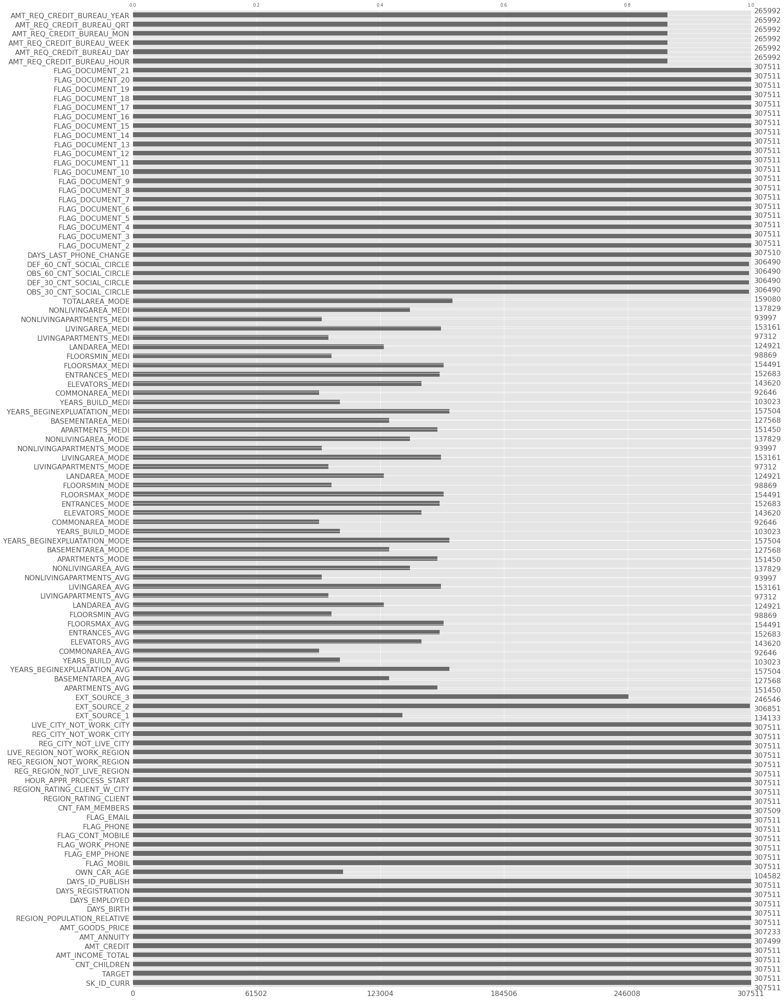

In [49]:
# Appel à la fonction
data_quality_assment(train_num)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 48744 entries, 0 to 48743
Columns: 105 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40)
memory usage: 39.4 MB

 Null values
                              Total  Pourcentage
COMMONAREA_MODE               33495        68.72
COMMONAREA_AVG                33495        68.72
COMMONAREA_MEDI               33495        68.72
NONLIVINGAPARTMENTS_MODE      33347        68.41
NONLIVINGAPARTMENTS_AVG       33347        68.41
NONLIVINGAPARTMENTS_MEDI      33347        68.41
LIVINGAPARTMENTS_MODE         32780        67.25
LIVINGAPARTMENTS_AVG          32780        67.25
LIVINGAPARTMENTS_MEDI         32780        67.25
FLOORSMIN_MODE                32466        66.61
FLOORSMIN_AVG                 32466        66.61
FLOORSMIN_MEDI                32466        66.61
OWN_CAR_AGE                   32312        66.29
YEARS_BUILD_AVG               31818        65.28
YEARS_BUILD_MODE              31818        65.28
YEARS_BUIL

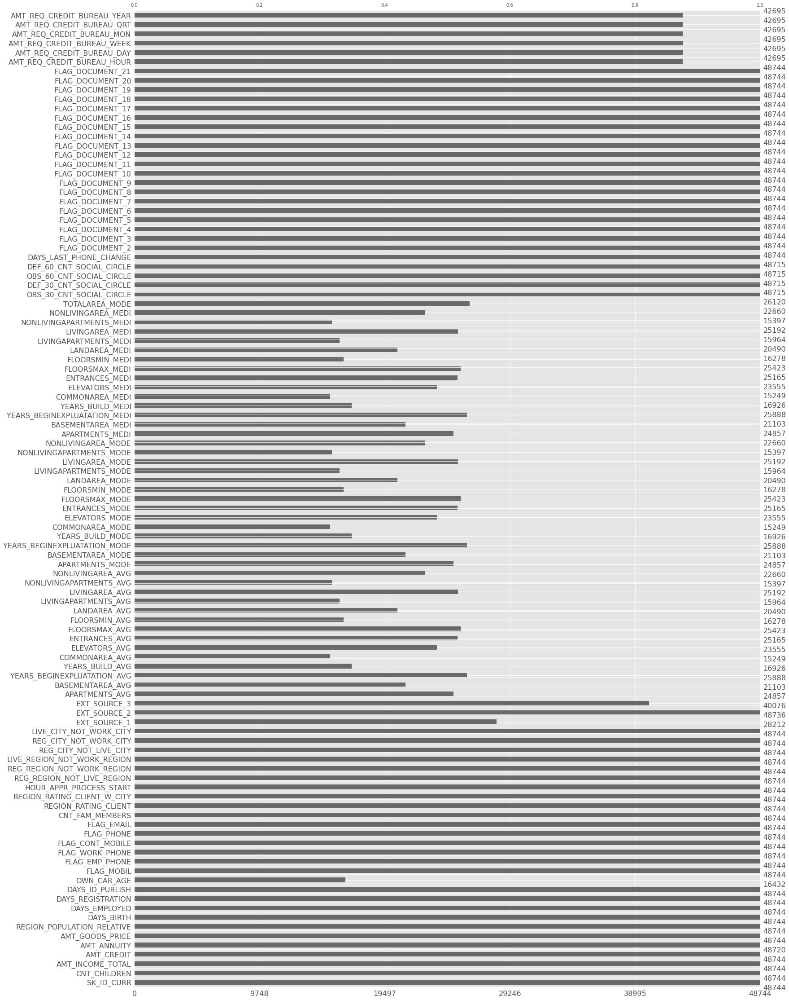

In [50]:
# Appel à la fonction
data_quality_assment(test_num)

In [51]:
# Pour les variables catégorielles
def describe_cat_columns(df):
    pd.set_option("display.max_column",106)
    for col in df:
    #print(col)
      if df[col].dtype == object:
        print(col)
        print('Categories and Count:')
        print(df[col].value_counts().to_string(header=None))
        print('\n')

In [52]:
# Appel à la fonction
describe_cat_columns(train_cat)

NAME_CONTRACT_TYPE
Categories and Count:
Cash loans         278232
Revolving loans     29279


CODE_GENDER
Categories and Count:
F      202448
M      105059
XNA         4


FLAG_OWN_CAR
Categories and Count:
N    202924
Y    104587


FLAG_OWN_REALTY
Categories and Count:
Y    213312
N     94199


NAME_TYPE_SUITE
Categories and Count:
Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271


NAME_INCOME_TYPE
Categories and Count:
Working                 158774
Commercial associate     71617
Pensioner                55362
State servant            21703
Unemployed                  22
Student                     18
Businessman                 10
Maternity leave              5


NAME_EDUCATION_TYPE
Categories and Count:
Secondary / secondary special    218391
Higher education                  74863
Incomplete higher                 10277
Lower secondary              

In [53]:
# Appel à la fonction
describe_cat_columns(test_cat)

NAME_CONTRACT_TYPE
Categories and Count:
Cash loans         48305
Revolving loans      439


CODE_GENDER
Categories and Count:
F    32678
M    16066


FLAG_OWN_CAR
Categories and Count:
N    32311
Y    16433


FLAG_OWN_REALTY
Categories and Count:
Y    33658
N    15086


NAME_TYPE_SUITE
Categories and Count:
Unaccompanied      39727
Family              5881
Spouse, partner     1448
Children             408
Other_B              211
Other_A              109
Group of people       49


NAME_INCOME_TYPE
Categories and Count:
Working                 24533
Commercial associate    11402
Pensioner                9273
State servant            3532
Student                     2
Businessman                 1
Unemployed                  1


NAME_EDUCATION_TYPE
Categories and Count:
Secondary / secondary special    33988
Higher education                 12516
Incomplete higher                 1724
Lower secondary                    475
Academic degree                     41


NAME_FAMILY_STATUS
Cate

Dans ce projet nous allons construire un algorithme capable de prédire si une personne sera en défaut de paiement ou pas (1: défaut,0: sans défaut. Il s'agit donc d'un problème de classification car nous voulons prédire est une variable catégorielle (binaire pour être précis)

Interessons nous aux différentes variables

## Variable cible " TARGET "

In [54]:
font_title = {"family": "serif",
              "color":  "#476bff",
              "weight": "bold",
              "size": 18}

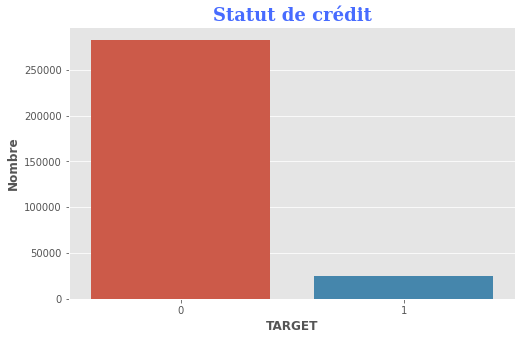

In [55]:
#Checking Distribution of Target Variable
plt.figure(figsize=(8,5))
sns.countplot(x = train_data['TARGET'])
plt.xlabel("TARGET", fontweight="bold")
plt.ylabel("Nombre", fontweight="bold")
plt.title("Statut de crédit", fontdict=font_title)
plt.show()

In [56]:
train_data['TARGET'].value_counts(normalize=True)

0    0.919271
1    0.080729
Name: TARGET, dtype: float64

On  a 92%  de nos clients qui ne sont pas en défaut de paiement celà veut dire que la majorité de nos clients ne sont pas en défaut de paiement et 8% de clients en défaut de paiement. On constate qu'on a un déséquilibre de classe et c'est visible dans notre graphique.

## Variables Catégorielles

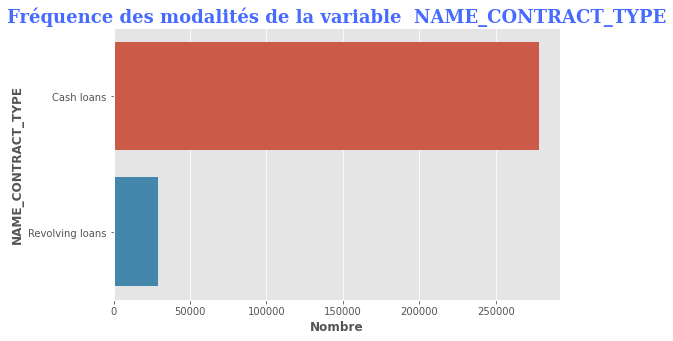

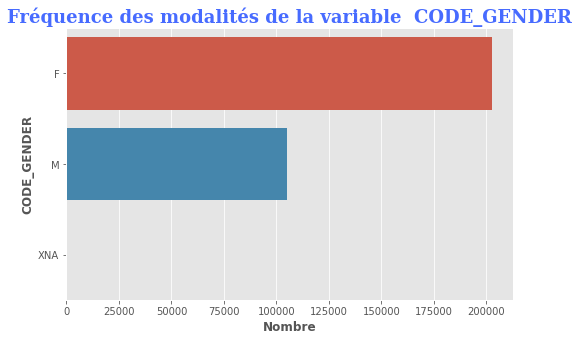

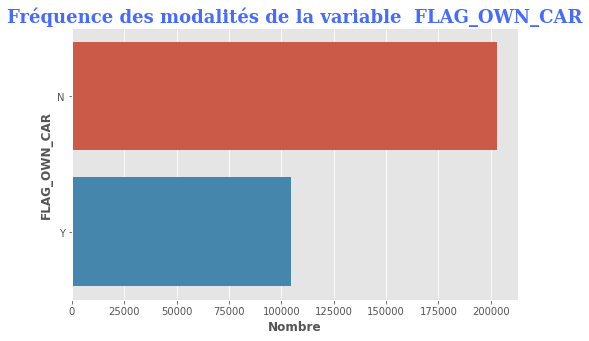

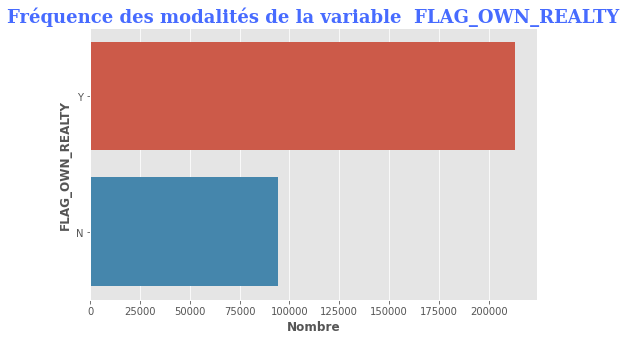

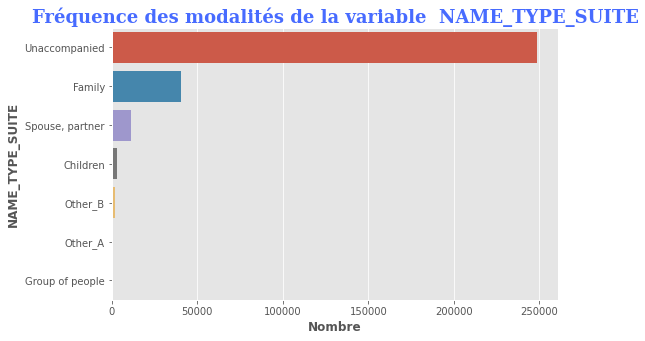

...

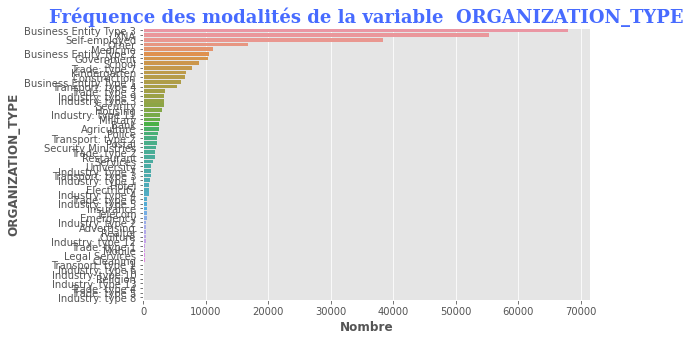

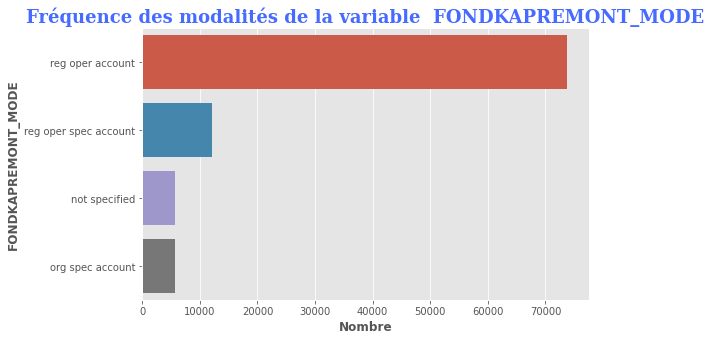

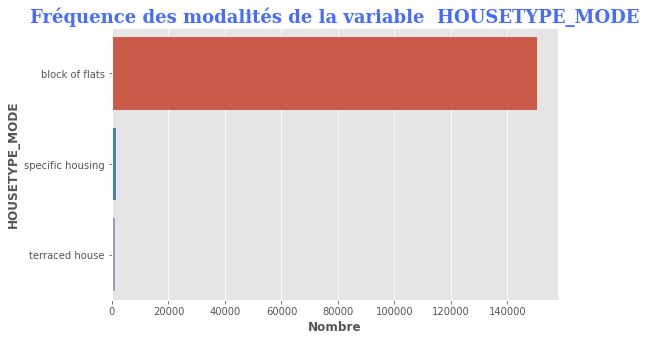

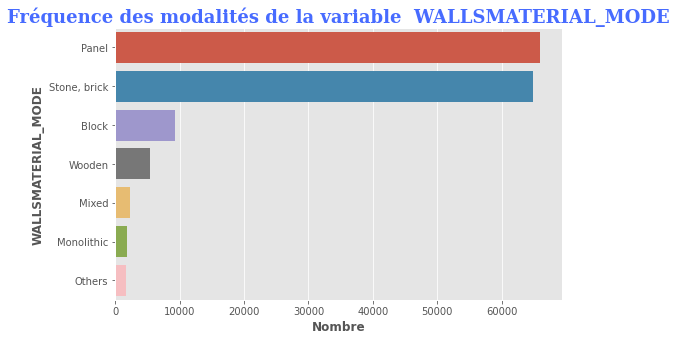

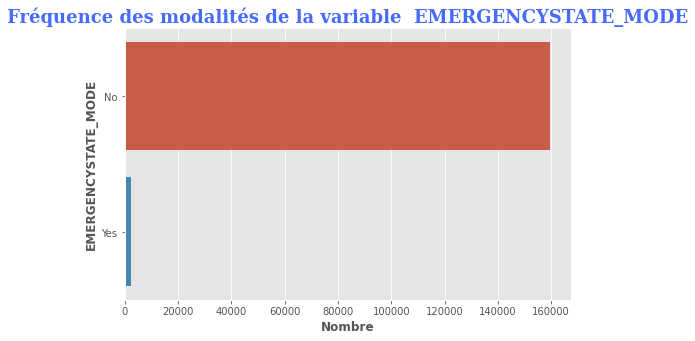

In [57]:
# Faisons une boucle for pour construire un diagamme à barre pour toutes les variables qualitatives(catégorielles)

for col in train_cat:
        #print(col)
        plt.figure(figsize=(8,5))
        sns.countplot(y=train_cat[col],order=train_cat[col].value_counts().index)
        plt.xlabel("Nombre", fontweight="bold")
        plt.ylabel(col, fontweight="bold")
        plt.title('Fréquence des modalités de la variable  ' + str(col), fontdict=font_title)
        plt.show()
        print('\n')

## Variables numériques (Histogramme et boites à moustache)**

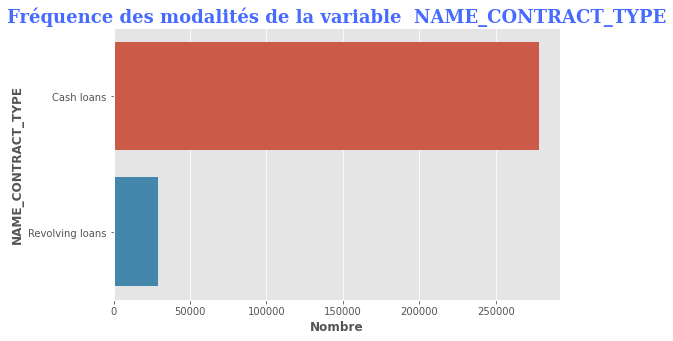

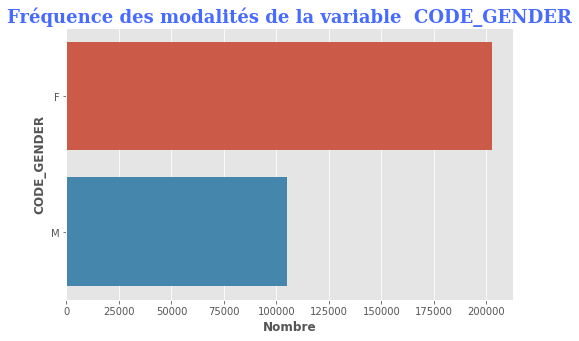

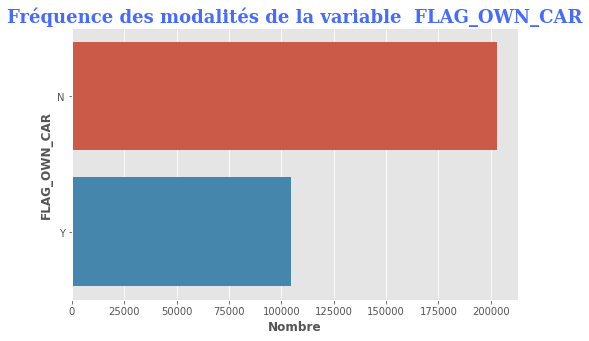

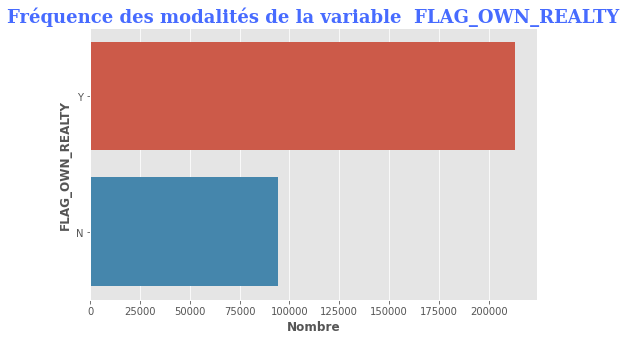

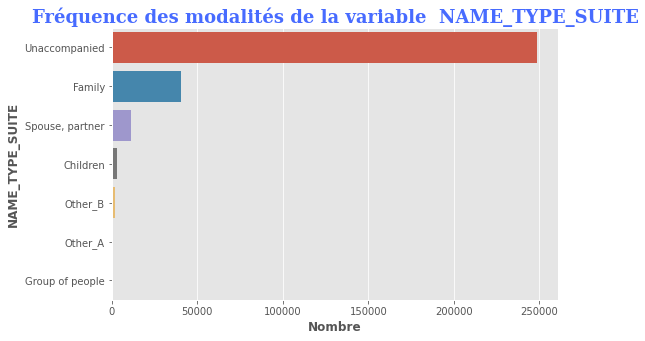

...

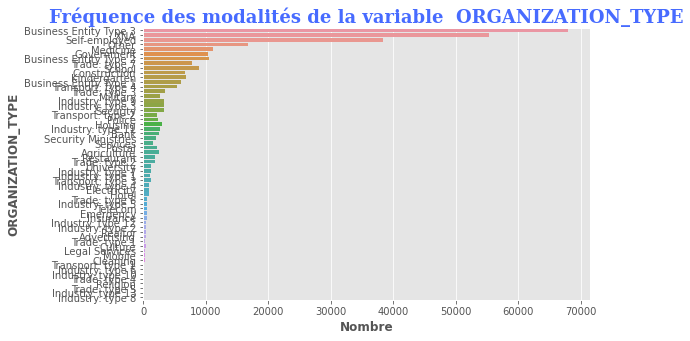

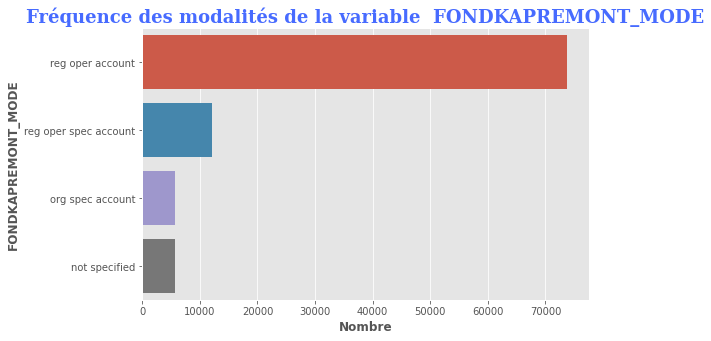

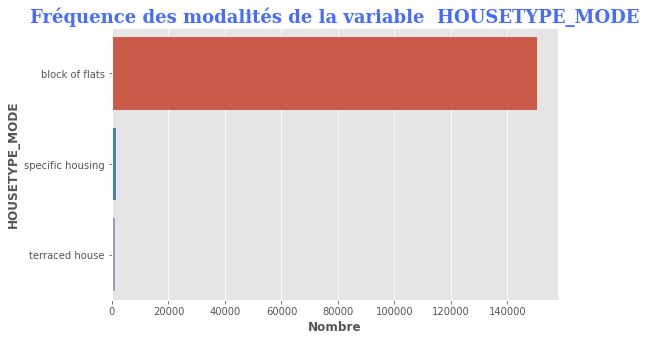

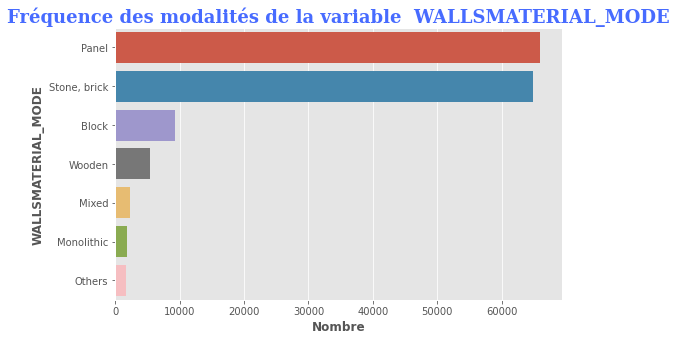

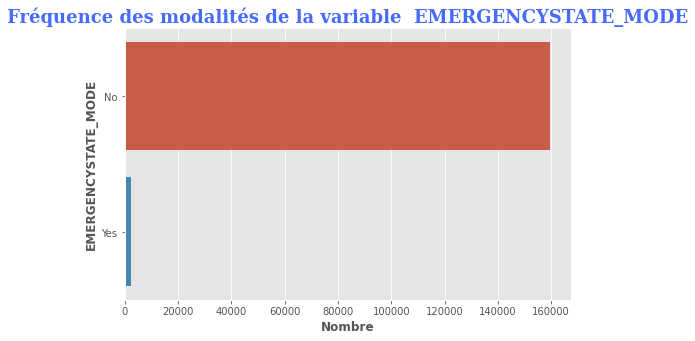

In [58]:
# Faisons une boucle for pour construire un diagamme à barre pour toutes les variables qualitatives(catégorielles)

for col in test_cat:
        #print(col)
        plt.figure(figsize=(8,5))
        sns.countplot(y=train_cat[col],order=test_cat[col].value_counts().index)
        plt.xlabel("Nombre", fontweight="bold")
        plt.ylabel(col, fontweight="bold")
        plt.title('Fréquence des modalités de la variable  ' + str(col), fontdict=font_title)
        plt.show()
        print('\n')

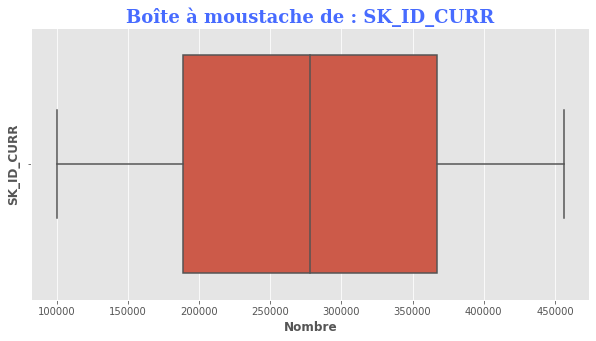

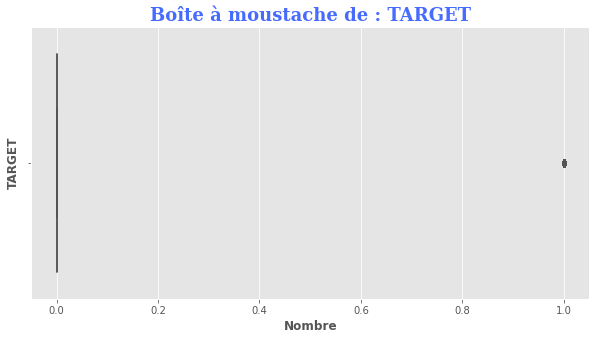

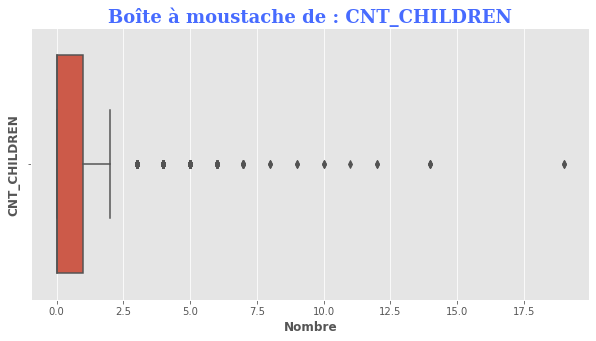

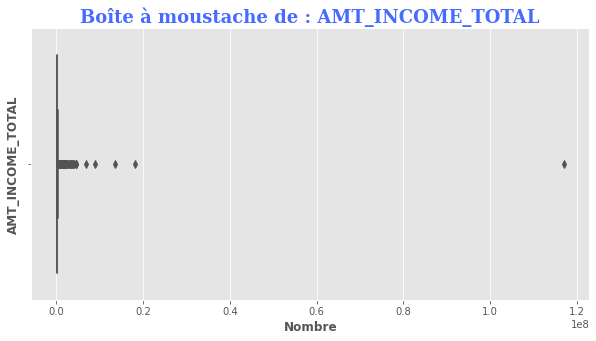

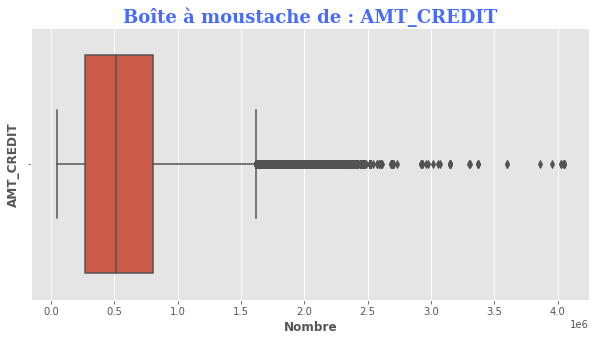

...

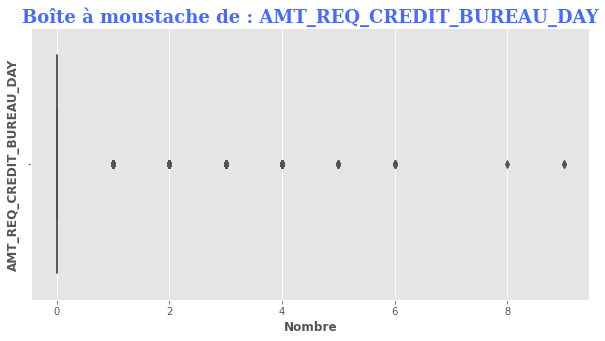

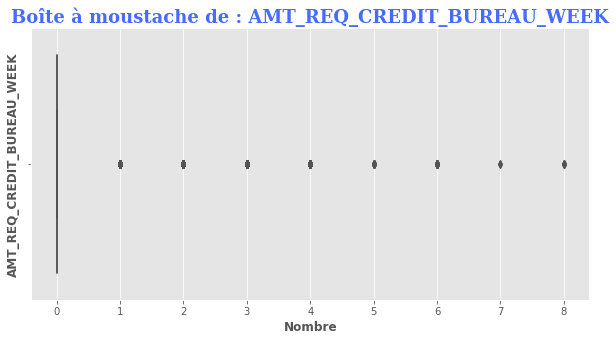

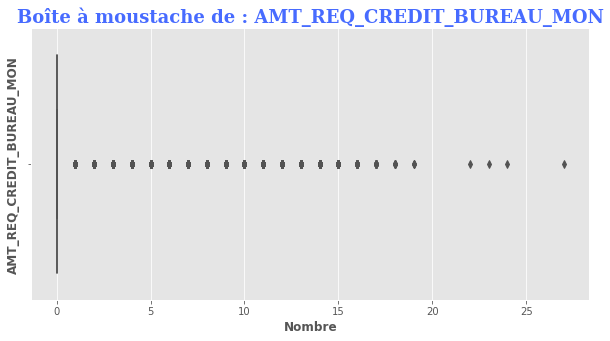

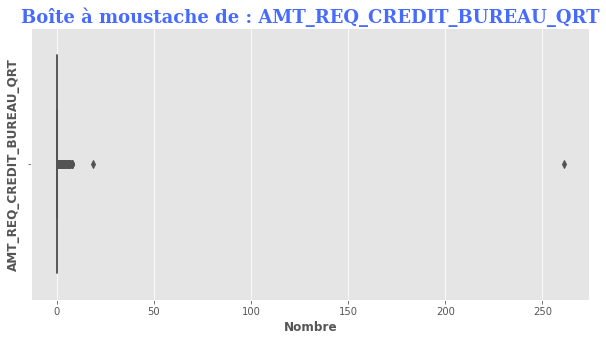

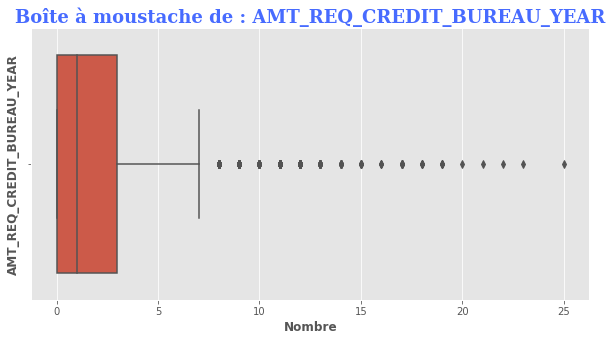

In [59]:
#Faisons une boucle for pour construire des boxplots pour toutes les variables quantitatives(numériques)
for col in train_num:
    #if col not in ["TARGET"]
    plt.figure(figsize=(10,5)) 
    sns.boxplot(train_num[col], showfliers = True)
    plt.xlabel("Nombre", fontweight="bold")
    plt.ylabel(col, fontweight="bold")
    plt.title('Boîte à moustache de : ' + str(col), fontdict=font_title) 
    plt.show()
    print('\n')

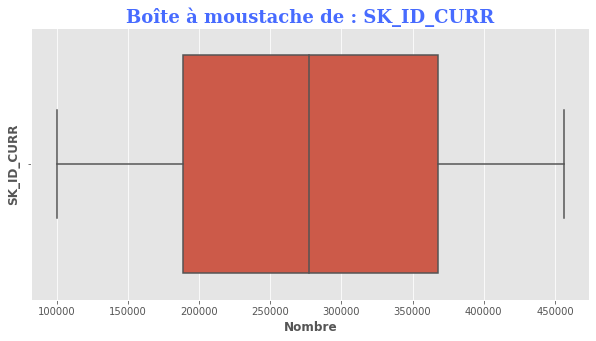

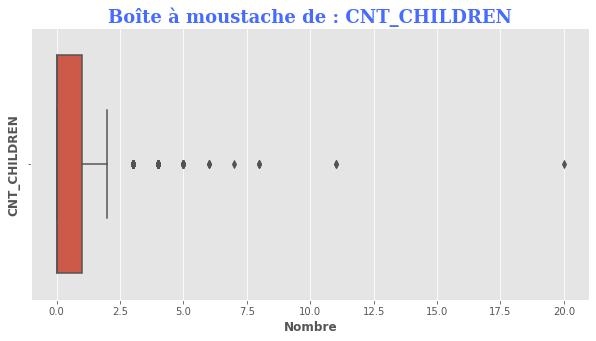

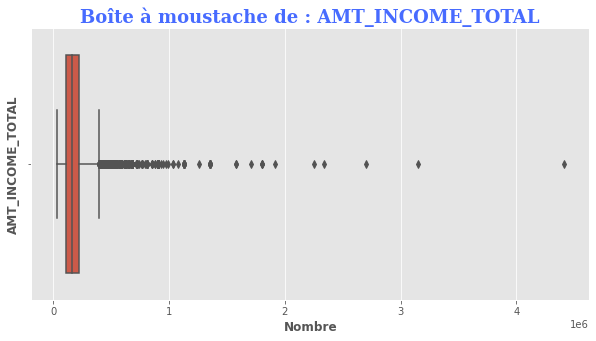

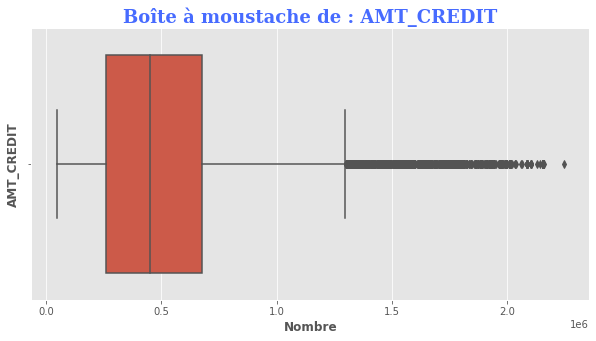

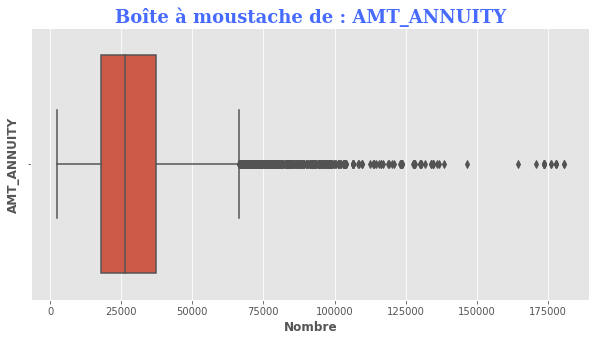

...

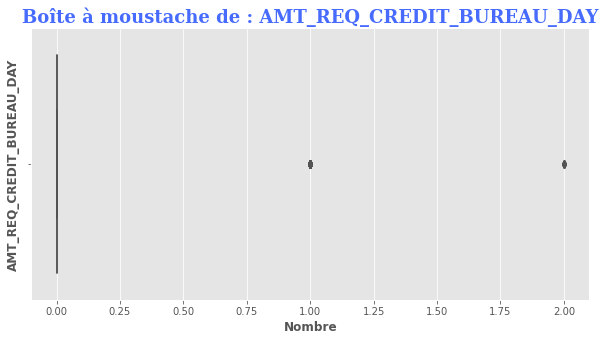

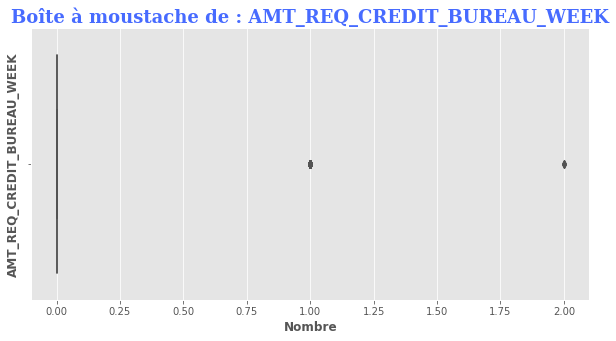

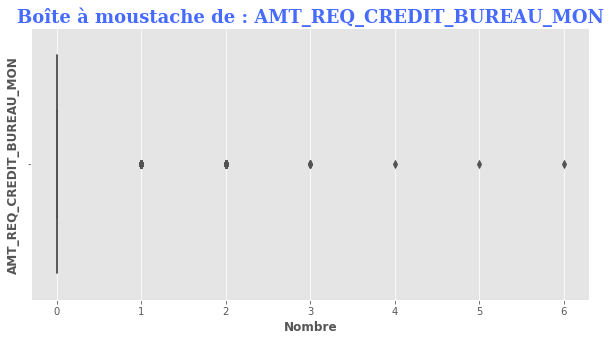

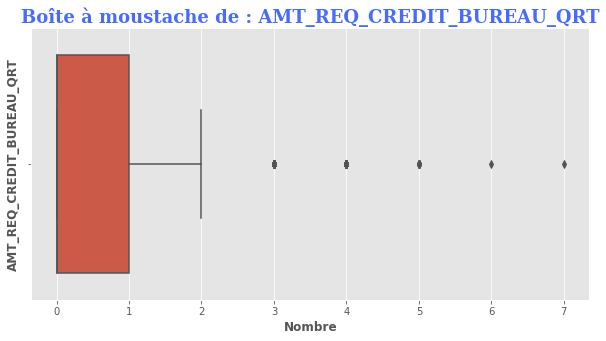

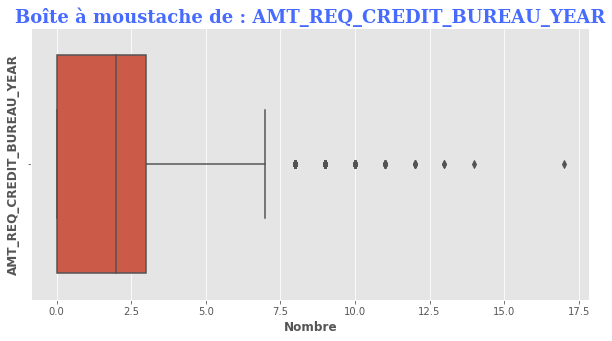

In [60]:
#Faisons une boucle for pour construire des boxplots pour toutes les variables quantitatives(numériques)
for col in test_num:
    #if col not in ["TARGET"]
    plt.figure(figsize=(10,5)) 
    sns.boxplot(test_num[col], showfliers = True)
    plt.xlabel("Nombre", fontweight="bold")
    plt.ylabel(col, fontweight="bold")
    plt.title('Boîte à moustache de : ' + str(col), fontdict=font_title) 
    plt.show()
    print('\n')

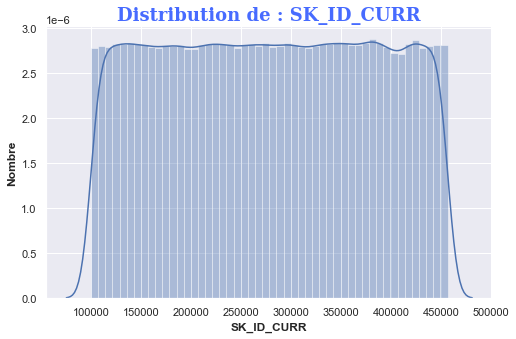

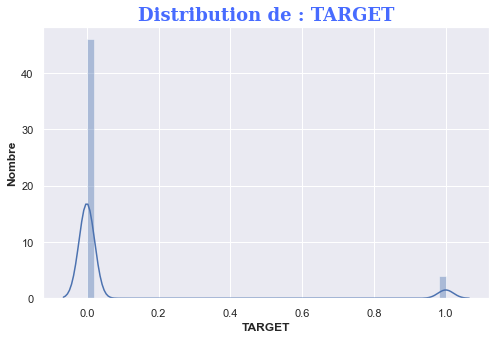

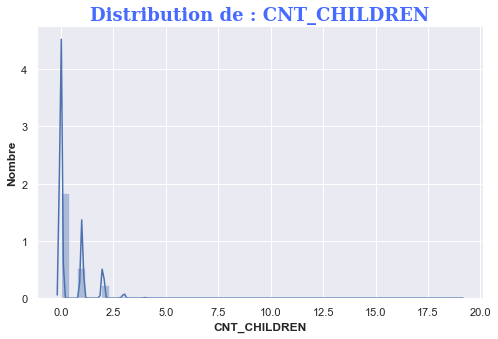

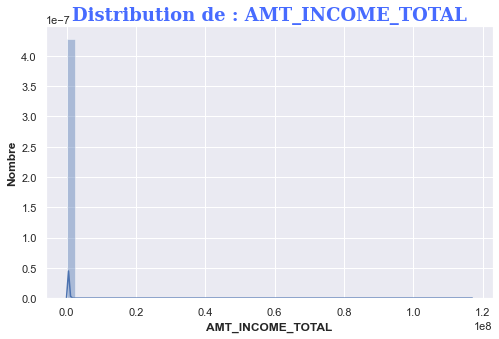

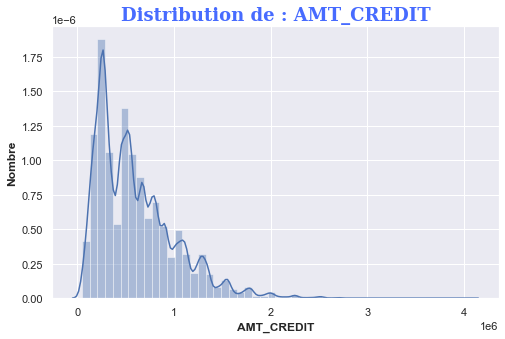

...

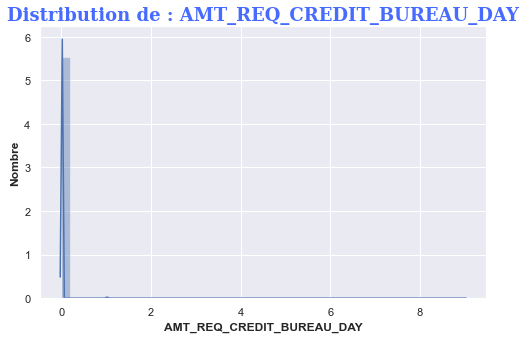

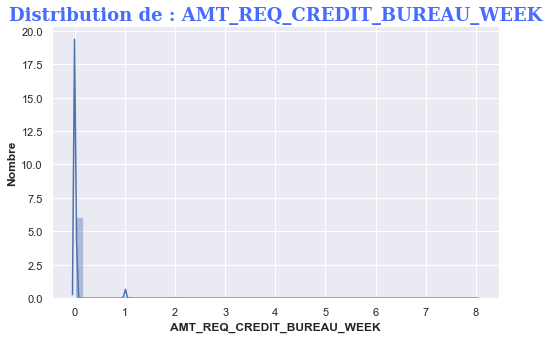

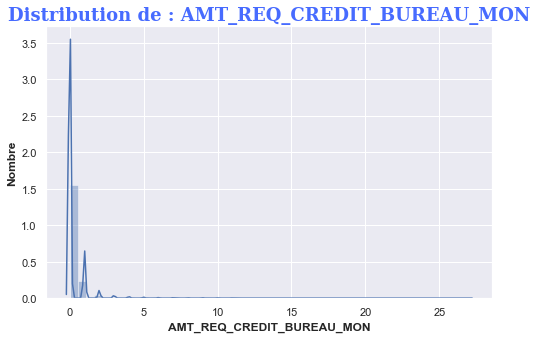

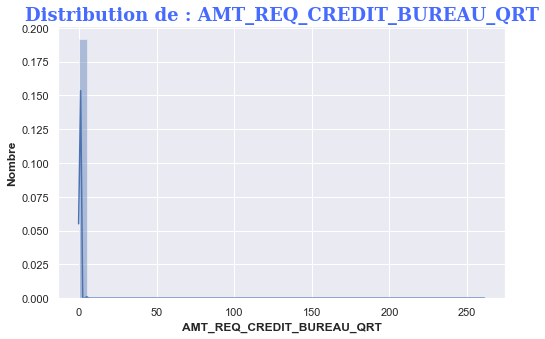

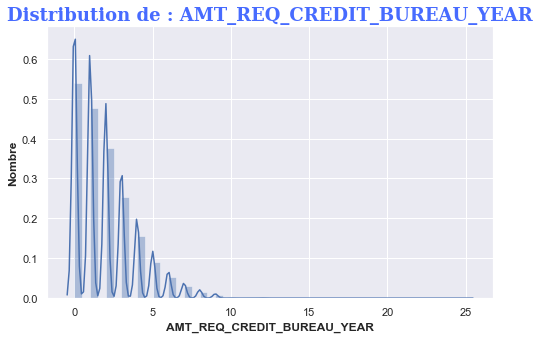

In [61]:
#Faisons une boucle for pour construire des histogrammes pour toutes les variables quantitatives(numériques)
for col in train_num:
    #if col not in ["TARGET"]
    plt.rcParams.update({ "font.size" : 13})
    sns.set(rc={'figure.figsize':(8,5)})
    plt.xlabel(col, fontweight="bold")
    plt.ylabel("Nombre",fontweight="bold")
    sns.distplot(train_num[col], kde = True)
    plt.title('Distribution de : ' + str(col), fontdict=font_title) 
    plt.show()
    print('\n')

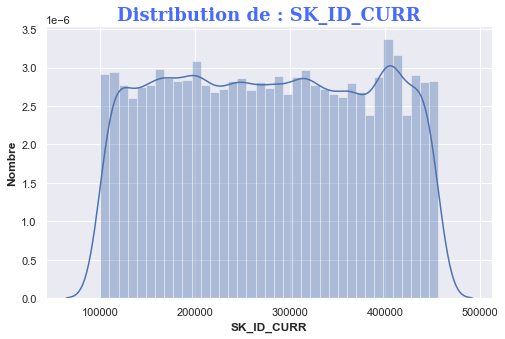

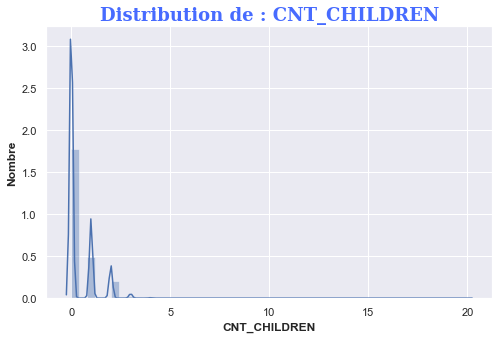

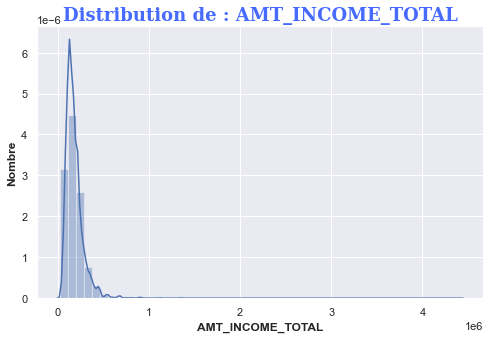

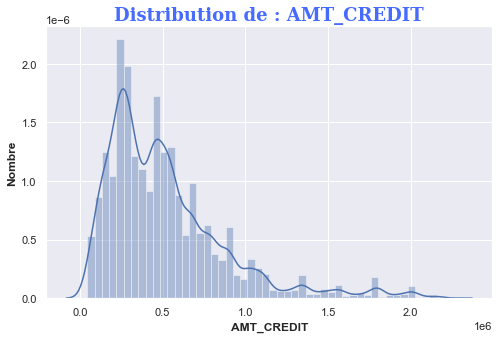

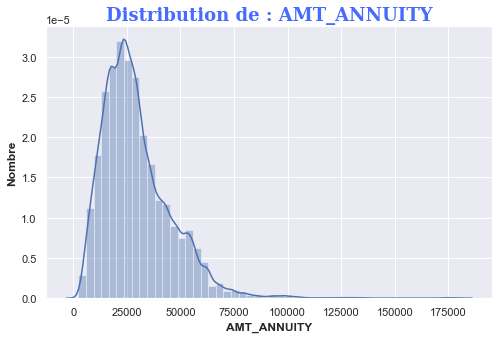

...

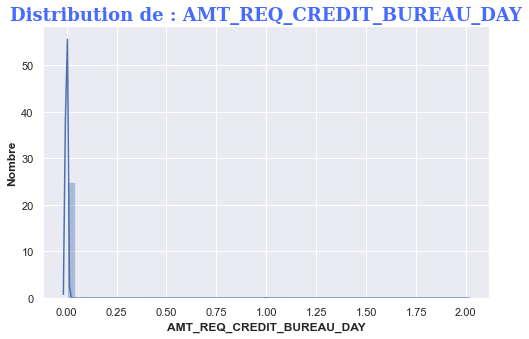

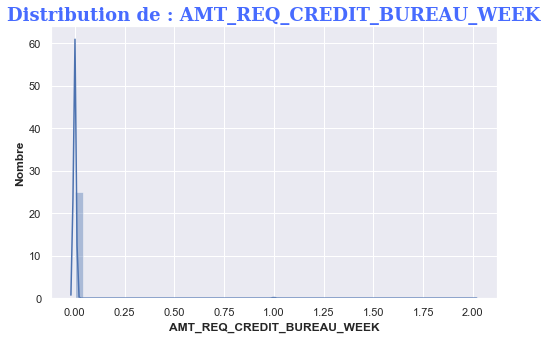

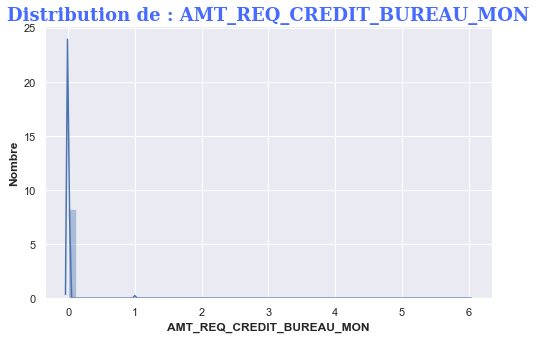

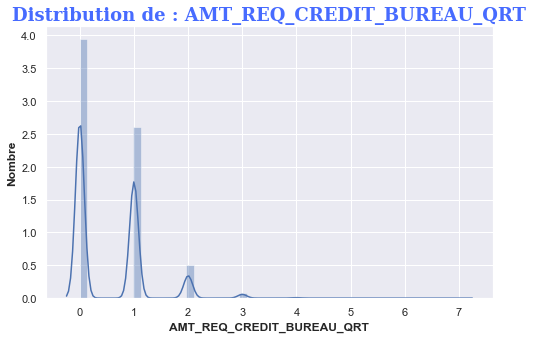

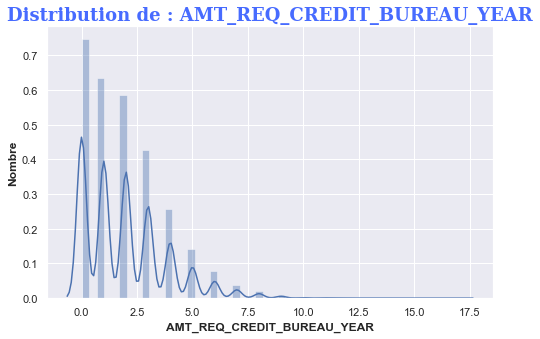

In [62]:
#Faisons une boucle for pour construire des histogrammes pour toutes les variables quantitatives(numériques)
for col in test_num:
    #if col not in ["TARGET"]
    plt.rcParams.update({ "font.size" : 13})
    sns.set(rc={'figure.figsize':(8,5)})
    plt.xlabel(col, fontweight="bold")
    plt.ylabel("Nombre",fontweight="bold")
    sns.distplot(test_num[col], kde = True)
    plt.title('Distribution de : ' + str(col), fontdict=font_title) 
    plt.show()
    print('\n')

### Variable 'DAYS_EMPLOYED'

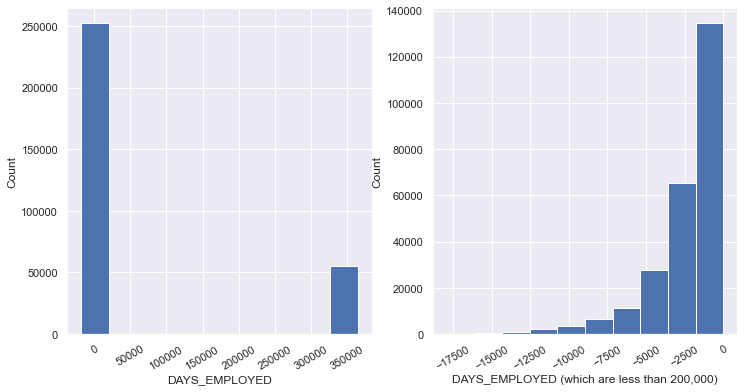

In [63]:
# Affiche l'histogramme du nombre de jours employés
fig = plt.figure(1, figsize=(12, 6))
plt.subplot(1, 2, 1)
train_data['DAYS_EMPLOYED'].hist()
plt.xlabel('DAYS_EMPLOYED')
plt.ylabel('Count')
plt.xticks(rotation=30)

# Affiche l'histogramme pour les valeurs normales
plt.subplot(1, 2, 2)
train_data.loc[train_data['DAYS_EMPLOYED'] < 200000, 'DAYS_EMPLOYED'].hist()
plt.xlabel('DAYS_EMPLOYED (which are less than 200,000)')
plt.ylabel('Count')
plt.xticks(rotation=30)
plt.show()

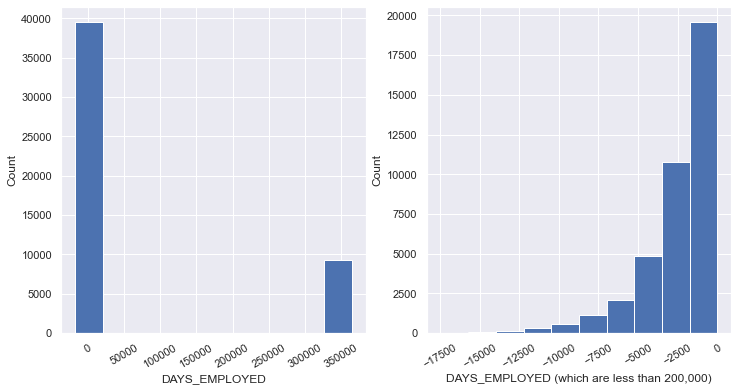

In [64]:
# Affiche l'histogramme du nombre de jours employés
fig = plt.figure(1, figsize=(12, 6))
plt.subplot(1, 2, 1)
test_data['DAYS_EMPLOYED'].hist()
plt.xlabel('DAYS_EMPLOYED')
plt.ylabel('Count')
plt.xticks(rotation=30)

# Affiche l'histogramme pour les valeurs normales
plt.subplot(1, 2, 2)
test_data.loc[test_data['DAYS_EMPLOYED'] < 200000, 'DAYS_EMPLOYED'].hist()
plt.xlabel('DAYS_EMPLOYED (which are less than 200,000)')
plt.ylabel('Count')
plt.xticks(rotation=30)
plt.show()

In [65]:
# Affiche les valeurs abérrantes
values_to_nan_train = train_data.loc[train_data['DAYS_EMPLOYED'] > 366, 'DAYS_EMPLOYED'].unique()
print(values_to_nan_train)

[365243]


In [66]:
# Affiche les valeurs abérrantes
values_to_nan_test = test_data.loc[test_data['DAYS_EMPLOYED'] > 366, 'DAYS_EMPLOYED'].unique()
print(values_to_nan_test)

[365243]


In [67]:
# Creation d'une nouvelle colonne qui contient les valeurs anormaux
train_data["DAYS_EMPLOYED_ANOM"] = train_data['DAYS_EMPLOYED'] == 365243

# Creation d'une nouvelle colonne qui contient les valeurs anormaux
test_data["DAYS_EMPLOYED_ANOM"] = test_data['DAYS_EMPLOYED'] == 365243

In [68]:
# Remplace la valeur abérrante par NaN
train_data['DAYS_EMPLOYED'].replace(values_to_nan_train, np.nan, inplace=True)

test_data['DAYS_EMPLOYED'].replace(values_to_nan_test, np.nan, inplace=True)

In [69]:
#notre colonne est bien rempli et la variable n'est pas normale
#nous allons remplacer les nan par la médiane 
train_data['DAYS_EMPLOYED'].fillna(train_data['DAYS_EMPLOYED'].median(),inplace=True)

In [70]:
#notre colonne est bien rempli et la variable n'est pas normale
#nous allons remplacer les nan par la médiane 
test_data['DAYS_EMPLOYED'].fillna(test_data['DAYS_EMPLOYED'].median(),inplace=True)

In [71]:
train_data["DAYS_EMPLOYED_ANOM"].isna().sum()

0

In [72]:
train_data["DAYS_EMPLOYED_ANOM"].value_counts()

False    252137
True      55374
Name: DAYS_EMPLOYED_ANOM, dtype: int64

In [73]:
test_data["DAYS_EMPLOYED_ANOM"].isna().sum()

0

In [74]:
test_data["DAYS_EMPLOYED_ANOM"].value_counts()

False    39470
True      9274
Name: DAYS_EMPLOYED_ANOM, dtype: int64

# Analyse bivariée

Analyse de nos variables catégorielles en fonction de notre variable cible "target" égal 0 si le client n'est pas en défaut de paiement et target égal 1 si le client est en défaut de paaiment.

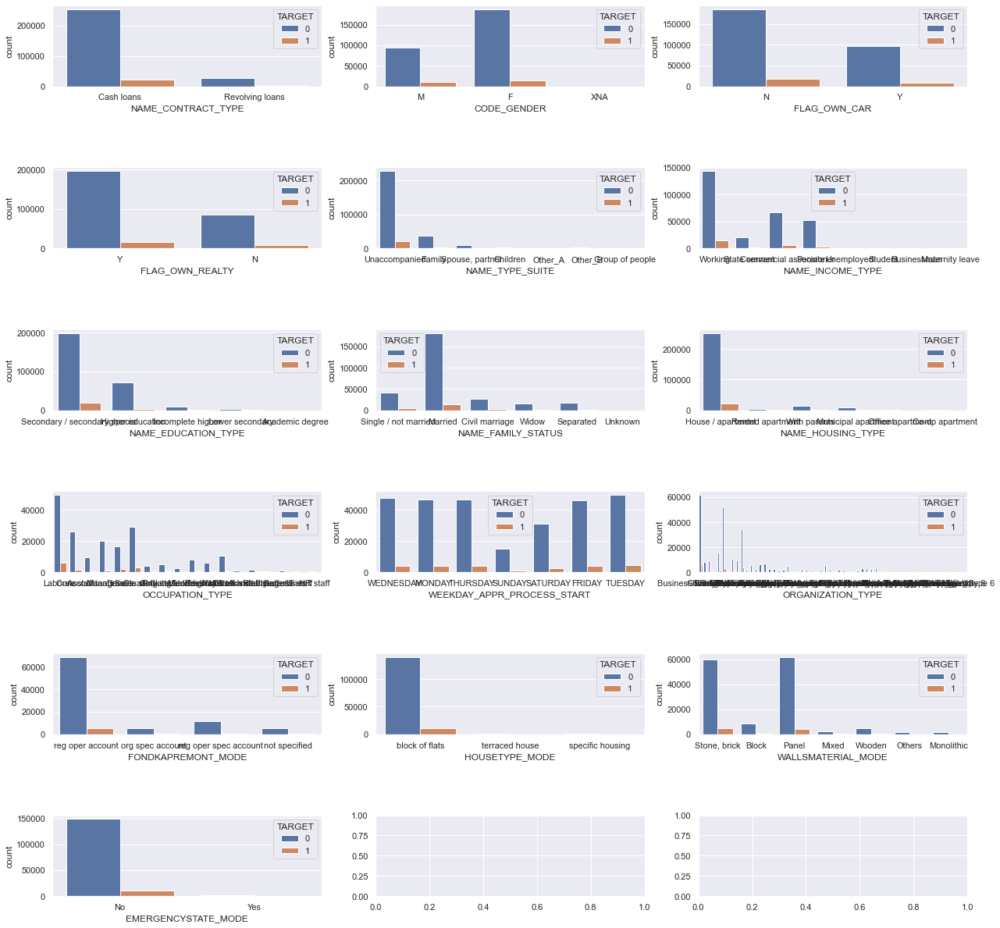

In [75]:
# les variables catégorielles
fig,axes=plt.subplots(6,3,figsize=(21,21))
for idx, cat_col in enumerate(train_cat):
    row,col=idx//3,idx%3
    sns.countplot(x=cat_col,data=train_data,hue=train_data['TARGET'],ax=axes[row,col])
plt.subplots_adjust(hspace=1)

# Nettoyage des données

Suppression de certaines lignes des variables catégorielles

Il ya certaines de ces lignes qui étaient présentes dans les données d'entrainement et absente dans les données test

In [76]:
# Supprime les individus dont le genre est 'XNA'
train_data = train_data[train_data['CODE_GENDER'] != 'XNA']
# Supprime les individus dont 'NAME_INCOME_TYPE' vient d'un congé maternité
train_data = train_data[train_data['NAME_INCOME_TYPE'] != 'Maternity leave']
# Supprime les individus dont la statut familial est inconnu
train_data = train_data[train_data['NAME_FAMILY_STATUS'] != 'Unknown']

## Features corrélés

In [77]:
#Affichage du dataset aprés suppresssions de certaines lignes
train_data.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,...,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,DAYS_EMPLOYED_ANOM
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637.0,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,...,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,False
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188.0,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,...,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225.0,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039.0,-9833.0,-2437,NaN,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [78]:
train_data.shape

(307500, 123)

In [79]:
# Build correlation table of edited features 
# Show only those higher than 0.75
feat_corr = pd.DataFrame(train_data).corr()
corr_df = feat_corr.where(np.triu(np.ones(feat_corr.shape), k = 1).astype(np.bool))
corr_df = corr_df.unstack().reset_index()
corr_df.columns = ['Feature A', 'Feature B', 'Correlation']
corr_df.dropna(subset = ['Correlation'], inplace = True)
corr_df['Correlation'] = round(corr_df['Correlation'], 2)
corr_df['Correlation'] = abs(corr_df['Correlation'])
matrix = corr_df.sort_values(by = 'Correlation', ascending = False)
max_corr = matrix[matrix['Correlation'] > 0.75]
max_corr

,Feature A,Feature B,Correlation
7316,FLOORSMIN_MEDI,FLOORSMIN_AVG,1.00
7100,ENTRANCES_MEDI,ENTRANCES_AVG,1.00
6884,COMMONAREA_MEDI,COMMONAREA_AVG,1.00
11356,DAYS_EMPLOYED_ANOM,FLAG_EMP_PHONE,1.00
8314,OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,1.00
7208,FLOORSMAX_MEDI,FLOORSMAX_AVG,1.00
6452,APARTMENTS_MEDI,APARTMENTS_AVG,1.00
6992,ELEVATORS_MEDI,ELEVATORS_AVG,1.00
7640,LIVINGAREA_MEDI,LIVINGAREA_AVG,1.00
6776,YEARS_BUILD_MEDI,YEARS_BUILD_AVG,1.00


In [80]:
# Build correlation table of edited features 
# Show only those higher than 0.75
feat_corr = pd.DataFrame(test_data).corr()
corr_df = feat_corr.where(np.triu(np.ones(feat_corr.shape), k = 1).astype(np.bool))
corr_df = corr_df.unstack().reset_index()
corr_df.columns = ['Feature A', 'Feature B', 'Correlation']
corr_df.dropna(subset = ['Correlation'], inplace = True)
corr_df['Correlation'] = round(corr_df['Correlation'], 2)
corr_df['Correlation'] = abs(corr_df['Correlation'])
matrix = corr_df.sort_values(by = 'Correlation', ascending = False)
max_corr = matrix[matrix['Correlation'] > 0.75]
max_corr

,Feature A,Feature B,Correlation
6606,YEARS_BUILD_MEDI,YEARS_BUILD_AVG,1.00
8130,OBS_60_CNT_SOCIAL_CIRCLE,OBS_30_CNT_SOCIAL_CIRCLE,1.00
7676,NONLIVINGAREA_MEDI,NONLIVINGAREA_AVG,1.00
6820,ELEVATORS_MEDI,ELEVATORS_AVG,1.00
6927,ENTRANCES_MEDI,ENTRANCES_AVG,1.00
6499,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_AVG,1.00
7034,FLOORSMAX_MEDI,FLOORSMAX_AVG,1.00
7141,FLOORSMIN_MEDI,FLOORSMIN_AVG,1.00
6713,COMMONAREA_MEDI,COMMONAREA_AVG,1.00
6285,APARTMENTS_MEDI,APARTMENTS_AVG,1.00


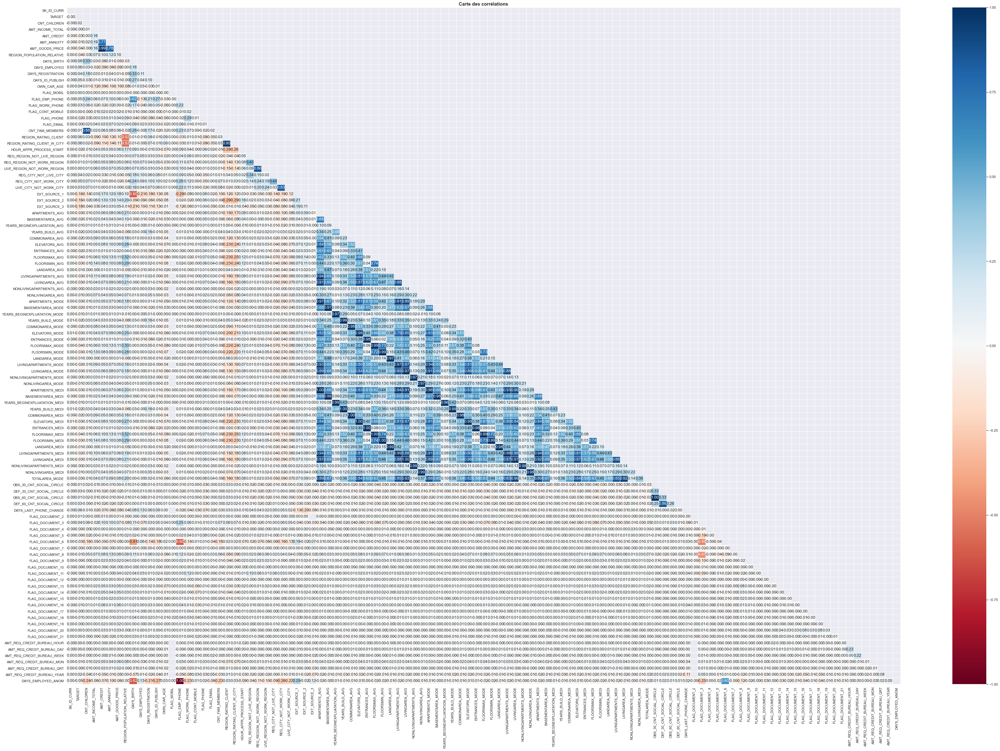

In [81]:
# Carte des corrélations

def plot_heatmap(df):
    cor_map = df.corr()
    plt.rcParams.update({ "font.size" : 13})
    plt.figure(figsize = (60, 40))
    mask = np.triu(np.ones_like(cor_map, dtype=bool))
    sns.heatmap(cor_map, mask=mask, center=0, cmap='RdBu', 
                linewidths=1, annot=True, fmt=".2f", vmin=-1, vmax=1)
    plt.title('Carte des corrélations', fontsize=15, fontweight="bold")
    plt.show()

plot_heatmap(train_data)

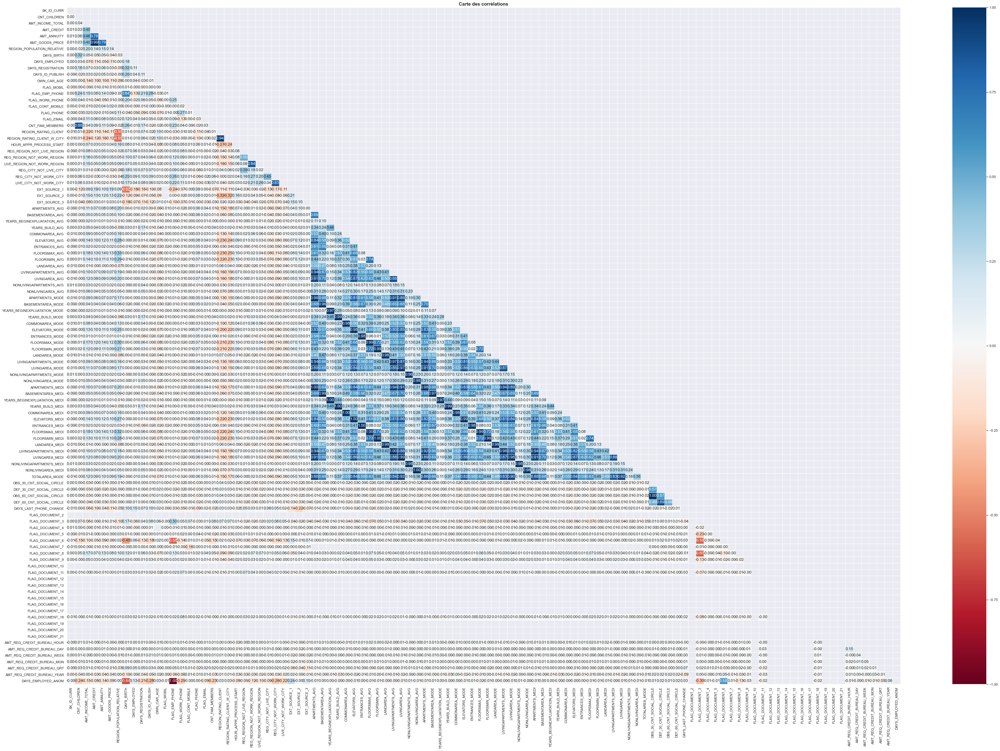

In [82]:
# Carte des corrélations

def plot_heatmap(df):
    cor_map = df.corr()
    plt.rcParams.update({ "font.size" : 13})
    plt.figure(figsize = (60, 40))
    mask = np.triu(np.ones_like(cor_map, dtype=bool))
    sns.heatmap(cor_map, mask=mask, center=0, cmap='RdBu', 
                linewidths=1, annot=True, fmt=".2f", vmin=-1, vmax=1)
    plt.title('Carte des corrélations', fontsize=15, fontweight="bold")
    plt.show()

plot_heatmap(test_data)

On voit qu'on a des variables qui sont fortement corrélées entres elles, donc nous allons supprimer l'une et garder l'autre afin d'éviter le problème de multicolinéarité au niveau des modèles.

In [83]:
# Création d'une liste des données à supprimer aprés verification 
# des variables corrélées
train_data = train_data.drop(columns=['APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
         'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE',
         'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE',
         'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE',  'NONLIVINGAREA_MODE', 
         'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI',  
         'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 
         'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI',
         'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI',  
         'FONDKAPREMONT_MODE', 'HOUSETYPE_MODE', 'TOTALAREA_MODE', 'WALLSMATERIAL_MODE',
         'EMERGENCYSTATE_MODE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 
         'OBS_60_CNT_SOCIAL_CIRCLE',  'DEF_60_CNT_SOCIAL_CIRCLE',
         'ORGANIZATION_TYPE'])

In [84]:
# Création d'une liste des données à supprimer aprés verification 
# des variables corrélées
test_data = test_data.drop(columns=['APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
         'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE',
         'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE',
         'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE',  'NONLIVINGAREA_MODE', 
         'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI',  
         'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 
         'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI',
         'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI',  
         'FONDKAPREMONT_MODE', 'HOUSETYPE_MODE', 'TOTALAREA_MODE', 'WALLSMATERIAL_MODE',
         'EMERGENCYSTATE_MODE', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 
         'OBS_60_CNT_SOCIAL_CIRCLE',  'DEF_60_CNT_SOCIAL_CIRCLE',
         'ORGANIZATION_TYPE'])

In [85]:
# Affichages des données aprés Supprerssion de ces features
pd.set_option("display.max_column",84)
train_data.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,...,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,DAYS_EMPLOYED_ANOM
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637.0,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,0.083037,0.262949,...,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,False
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188.0,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,0.311267,0.622246,...,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225.0,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,NaN,0.555912,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039.0,-9833.0,-2437,NaN,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,NaN,0.650442,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,False
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038.0,-4311.0,-3458,NaN,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,NaN,0.322738,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False


In [86]:
train_data.shape

(307500, 85)

In [87]:
# Affichages des données aprés Supprerssion de ces features
pd.set_option("display.max_column",84)
test_data.head(5)

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,DAYS_EMPLOYED_ANOM
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329.0,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,False
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469.0,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0,False
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458.0,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0,False
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.026392,-13976,-1866.0,-2000.0,-4208,NaN,1,1,0,1,1,0,Sales staff,4.0,2,2,WEDNESDAY,11,0,0,0,0,0,0,0.525734,0.509677,0.612704,0.3052,0.1974,0.9970,0.9592,0.1165,0.32,0.2759,0.375,0.0417,0.2042,0.2404,0.3673,0.0386,0.08,-1805.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0,False
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010032,-13040,-2191.0,-4000.0,-4262,16.0,1,1,1,1,0,0,NaN,3.0,2,2,FRIDAY,5,0,0,0,0,1,1,0.202145,0.425687,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-821.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,False


In [88]:
test_data.shape

(48744, 84)

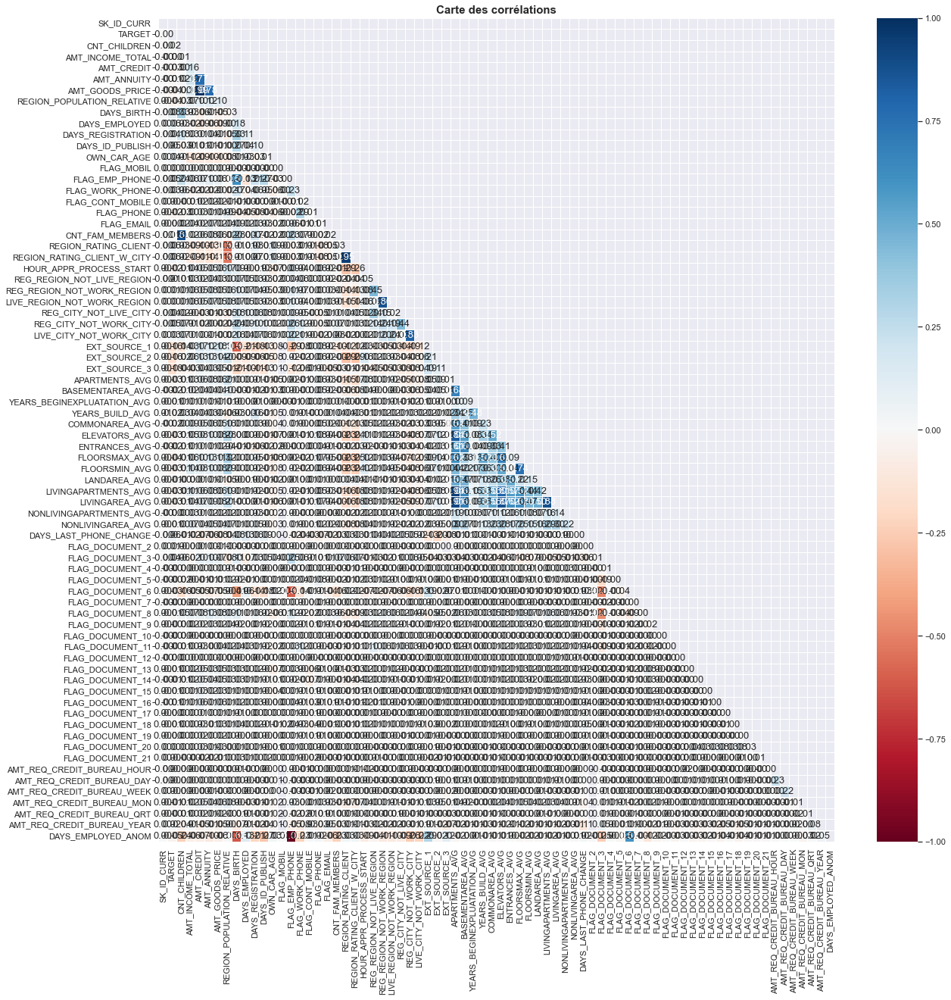

In [89]:
# Carte des corrélations

def plot_heatmap(df):
    cor_map = df.corr()
    plt.rcParams.update({ "font.size" : 13})
    plt.figure(figsize = (20, 20))
    mask = np.triu(np.ones_like(cor_map, dtype=bool))
    sns.heatmap(cor_map, mask=mask, center=0, cmap='RdBu', 
                linewidths=1, annot=True, fmt=".2f", vmin=-1, vmax=1)
    plt.title('Carte des corrélations', fontsize=15, fontweight="bold")
    plt.show()

plot_heatmap(train_data)

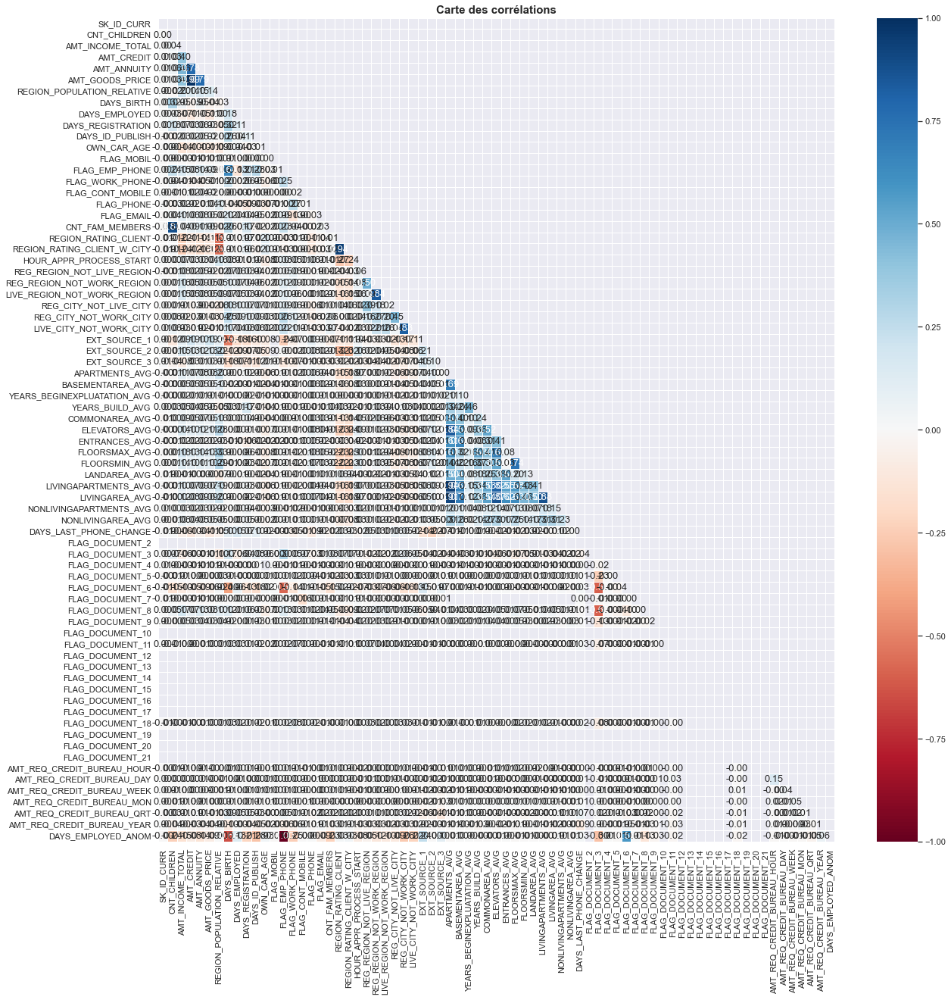

In [90]:
# Carte des corrélations

def plot_heatmap(df):
    cor_map = df.corr()
    plt.rcParams.update({ "font.size" : 13})
    plt.figure(figsize = (20, 20))
    mask = np.triu(np.ones_like(cor_map, dtype=bool))
    sns.heatmap(cor_map, mask=mask, center=0, cmap='RdBu', 
                linewidths=1, annot=True, fmt=".2f", vmin=-1, vmax=1)
    plt.title('Carte des corrélations', fontsize=15, fontweight="bold")
    plt.show()

plot_heatmap(test_data)

Il est logique que AMT_CREDIT (montant du crédit du prêt) et AMT_GOODS_PRICE (pour les prêts à la consommation, c'est le prix des biens pour lesquels le prêt est accordé) soient corrélés
Comme le montant du crédit est applicable à tous les prêts

In [91]:
# Créer une variable de corrélation
corr1 = train_data.corr()['TARGET'].sort_values()

# Corrélation négative la plus forte
print('Features avec de fortes corrélation négatives:')
corr1.head(5)

Features avec de fortes corrélation négatives:


EXT_SOURCE_3         -0.178926
EXT_SOURCE_2         -0.160451
EXT_SOURCE_1         -0.155333
DAYS_EMPLOYED_ANOM   -0.045983
FLOORSMAX_AVG        -0.044005
Name: TARGET, dtype: float64

In [92]:
# Corrélation positive la plus forte
print('Features avec de fortes corrélation positives:')
corr1.tail(5)

Features avec de fortes corrélation positives:


REGION_RATING_CLIENT           0.058882
REGION_RATING_CLIENT_W_CITY    0.060875
DAYS_EMPLOYED                  0.063381
DAYS_BIRTH                     0.078236
TARGET                         1.000000
Name: TARGET, dtype: float64

In [93]:
#Vérification de la corrélation avec la variable CIBLE
train_data.corr()['TARGET'].abs().sort_values().head(100)

FLAG_DOCUMENT_20               0.000216
FLAG_DOCUMENT_5                0.000306
FLAG_CONT_MOBILE               0.000370
FLAG_MOBIL                     0.000534
FLAG_DOCUMENT_12               0.000756
AMT_REQ_CREDIT_BUREAU_WEEK     0.000787
AMT_REQ_CREDIT_BUREAU_HOUR     0.000930
FLAG_DOCUMENT_19               0.001357
FLAG_DOCUMENT_7                0.001404
FLAG_DOCUMENT_10               0.001414
FLAG_EMAIL                     0.001755
AMT_REQ_CREDIT_BUREAU_QRT      0.002023
SK_ID_CURR                     0.002137
FLAG_DOCUMENT_4                0.002672
AMT_REQ_CREDIT_BUREAU_DAY      0.002704
LIVE_REGION_NOT_WORK_REGION    0.002832
NONLIVINGAPARTMENTS_AVG        0.003177
FLAG_DOCUMENT_17               0.003377
FLAG_DOCUMENT_21               0.003709
AMT_INCOME_TOTAL               0.003970
FLAG_DOCUMENT_11               0.004229
FLAG_DOCUMENT_9                0.004352
FLAG_DOCUMENT_2                0.005417
REG_REGION_NOT_LIVE_REGION     0.005578
FLAG_DOCUMENT_15               0.006535


In [94]:
# Suppression des variables qui ont de faibles corrélations avec la variable target
train_data = train_data.drop(columns=['FLAG_DOCUMENT_20','FLAG_DOCUMENT_5','FLAG_CONT_MOBILE','FLAG_MOBIL','FLAG_DOCUMENT_12',
                         'AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_HOUR','FLAG_DOCUMENT_19','FLAG_DOCUMENT_10','FLAG_DOCUMENT_7',
                         'FLAG_EMAIL','AMT_REQ_CREDIT_BUREAU_QRT','FLAG_DOCUMENT_4','AMT_REQ_CREDIT_BUREAU_DAY',
                         'LIVE_REGION_NOT_WORK_REGION','FLAG_DOCUMENT_17','FLAG_DOCUMENT_21','FLAG_DOCUMENT_11',
                         'FLAG_DOCUMENT_9','FLAG_DOCUMENT_2','REG_REGION_NOT_LIVE_REGION','FLAG_DOCUMENT_15','REG_REGION_NOT_WORK_REGION',
                         'FLAG_DOCUMENT_18','FLAG_DOCUMENT_8', 'CNT_FAM_MEMBERS', 'FLOORSMAX_AVG',
                         'FLAG_DOCUMENT_14','FLAG_DOCUMENT_13','FLAG_DOCUMENT_16','AMT_REQ_CREDIT_BUREAU_MON','CNT_CHILDREN',
                         'AMT_REQ_CREDIT_BUREAU_YEAR', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 
                         'ENTRANCES_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 
                         'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'YEARS_BUILD_AVG'])

In [95]:
# Suppression des variables qui ont de faibles corrélations avec la variable target
test_data = test_data.drop(columns=['FLAG_DOCUMENT_20','FLAG_DOCUMENT_5','FLAG_CONT_MOBILE','FLAG_MOBIL','FLAG_DOCUMENT_12',
                         'AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_HOUR','FLAG_DOCUMENT_19','FLAG_DOCUMENT_10','FLAG_DOCUMENT_7',
                         'FLAG_EMAIL','AMT_REQ_CREDIT_BUREAU_QRT','FLAG_DOCUMENT_4','AMT_REQ_CREDIT_BUREAU_DAY',
                         'LIVE_REGION_NOT_WORK_REGION','FLAG_DOCUMENT_17','FLAG_DOCUMENT_21','FLAG_DOCUMENT_11',
                         'FLAG_DOCUMENT_9','FLAG_DOCUMENT_2','REG_REGION_NOT_LIVE_REGION','FLAG_DOCUMENT_15','REG_REGION_NOT_WORK_REGION',
                         'FLAG_DOCUMENT_18','FLAG_DOCUMENT_8', 'CNT_FAM_MEMBERS', 'FLOORSMAX_AVG',
                         'FLAG_DOCUMENT_14','FLAG_DOCUMENT_13','FLAG_DOCUMENT_16','AMT_REQ_CREDIT_BUREAU_MON','CNT_CHILDREN',
                         'AMT_REQ_CREDIT_BUREAU_YEAR', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 
                         'ENTRANCES_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 
                         'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'YEARS_BUILD_AVG'])

In [96]:
# Affichage des données aprés suppression de certaines variables
pd.set_option("display.max_column",51)
train_data.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,OCCUPATION_TYPE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM
0,100002,1,Cash loans,M,N,Y,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637.0,-3648.0,-2120,NaN,1,0,1,Laborers,2,2,WEDNESDAY,10,0,0,0,0.083037,0.262949,0.139376,0.9722,-1134.0,1,0,False
1,100003,0,Cash loans,F,N,N,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188.0,-1186.0,-291,NaN,1,0,1,Core staff,1,1,MONDAY,11,0,0,0,0.311267,0.622246,NaN,0.9851,-828.0,1,0,False
2,100004,0,Revolving loans,M,Y,Y,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225.0,-4260.0,-2531,26.0,1,1,1,Laborers,2,2,MONDAY,9,0,0,0,NaN,0.555912,0.729567,NaN,-815.0,0,0,False
3,100006,0,Cash loans,F,N,Y,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039.0,-9833.0,-2437,NaN,1,0,0,Laborers,2,2,WEDNESDAY,17,0,0,0,NaN,0.650442,NaN,NaN,-617.0,1,0,False
4,100007,0,Cash loans,M,N,Y,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038.0,-4311.0,-3458,NaN,1,0,0,Core staff,2,2,THURSDAY,11,0,1,1,NaN,0.322738,NaN,NaN,-1106.0,0,0,False


In [97]:
train_data.shape

(307500, 40)

In [98]:
# Affichage des données aprés suppression de certaines variables
pd.set_option("display.max_column",51)
test_data.head(5)

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,OCCUPATION_TYPE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM
0,100001,Cash loans,F,N,Y,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329.0,-5170.0,-812,NaN,1,0,0,NaN,2,2,TUESDAY,18,0,0,0,0.752614,0.789654,0.159520,0.9732,-1740.0,1,0,False
1,100005,Cash loans,M,N,Y,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469.0,-9118.0,-1623,NaN,1,0,0,Low-skill Laborers,2,2,FRIDAY,9,0,0,0,0.564990,0.291656,0.432962,NaN,0.0,1,0,False
2,100013,Cash loans,M,Y,Y,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458.0,-2175.0,-3503,5.0,1,0,0,Drivers,2,2,MONDAY,14,0,0,0,NaN,0.699787,0.610991,NaN,-856.0,0,0,False
3,100028,Cash loans,F,N,Y,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.026392,-13976,-1866.0,-2000.0,-4208,NaN,1,0,1,Sales staff,2,2,WEDNESDAY,11,0,0,0,0.525734,0.509677,0.612704,0.9970,-1805.0,1,0,False
4,100038,Cash loans,M,Y,N,180000.0,625500.0,32067.0,625500.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010032,-13040,-2191.0,-4000.0,-4262,16.0,1,1,0,NaN,2,2,FRIDAY,5,0,1,1,0.202145,0.425687,NaN,NaN,-821.0,1,0,False


In [99]:
test_data.shape

(48744, 39)

## Conversion de certaines variables

In [100]:
(train_data['DAYS_BIRTH'] / -365).describe()

count    307500.000000
mean         43.937176
std          11.956134
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

In [101]:
# Convertir DAYS_BIRTH en années
train_data['DAYS_BIRTH'] = abs(train_data['DAYS_BIRTH'])
train_data['DAYS_BIRTH'].corr(train_data['TARGET'])


-0.07823618230487006

In [102]:
# Convertir DAYS_BIRTH en années
test_data['DAYS_BIRTH'] = abs(test_data['DAYS_BIRTH'])
test_data['DAYS_BIRTH'].corr(train_data['TARGET'])


0.005188523198922093

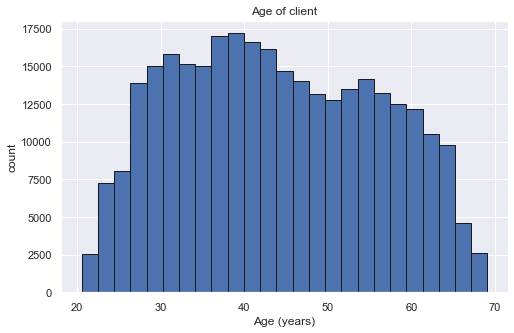

In [103]:
# plot the distribution of ages in years
plt.hist(train_data['DAYS_BIRTH'] / 365 , edgecolor = 'k', bins=25)
plt.title('Age of client');
plt.xlabel('Age (years)');
plt.ylabel('count');

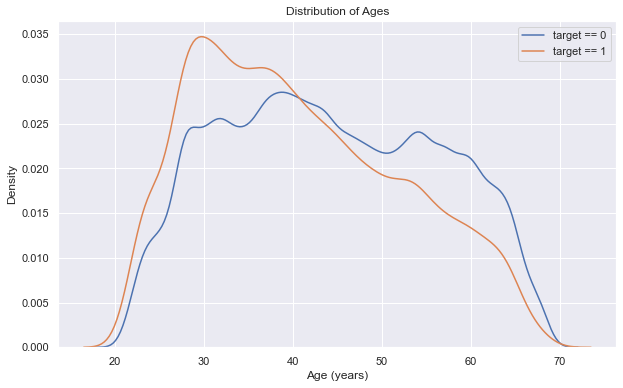

In [104]:
plt.figure(figsize=(10, 6))
# KDE densite par noyau plot des prets qui ont ete remboursés
sns.kdeplot(train_data.loc[train_data['TARGET'] == 0, 'DAYS_BIRTH'] /365, label= 'target == 0')
# KDE plot des prets qui n'ont pas ete remboursés
sns.kdeplot(train_data.loc[train_data['TARGET'] == 1, 'DAYS_BIRTH'] / 365, label= 'target == 1')
# Labeling of plot
plt.xlabel('Age (years)');
plt.ylabel('Density');
plt.legend();
plt.title('Distribution of Ages');

In [105]:
# Nous prenons que l'age des clients et notre variable cible
age_data = train_data.loc[:,['TARGET', "DAYS_BIRTH"]]
age_data['YEARS_BIRTH'] = age_data.loc[:,'DAYS_BIRTH'] / 365
#on prend l'age  de naissance

# on le coupe par tranche en utilisant pd.cut pour un intervalle allanr de [20,70]
#num le nombre dechantillon à générer 
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins=np.linspace(20,70, num=11))
age_data.head(10)

,TARGET,DAYS_BIRTH,YEARS_BIRTH,YEARS_BINNED
0,1,9461,25.920548,"(25.0, 30.0]"
1,0,16765,45.931507,"(45.0, 50.0]"
2,0,19046,52.180822,"(50.0, 55.0]"
3,0,19005,52.068493,"(50.0, 55.0]"
4,0,19932,54.608219,"(50.0, 55.0]"
5,0,16941,46.413699,"(45.0, 50.0]"
6,0,13778,37.747945,"(35.0, 40.0]"
7,0,18850,51.643836,"(50.0, 55.0]"
8,0,20099,55.065753,"(55.0, 60.0]"
9,0,14469,39.641096,"(35.0, 40.0]"


In [106]:
# on fait un groupby sur la tranche d'age et on calcule la moyenne
#des variables target jours de naissance, age 
age_groups = age_data.groupby('YEARS_BINNED').mean()
age_groups

,TARGET,DAYS_BIRTH,YEARS_BIRTH
YEARS_BINNED,,,
"(20.0, 25.0]",0.123036,8532.795625,23.377522
"(25.0, 30.0]",0.111446,10155.239052,27.822573
"(30.0, 35.0]",0.102817,11854.834656,32.478999
"(35.0, 40.0]",0.089376,13707.926605,37.555963
"(40.0, 45.0]",0.078493,15497.674629,42.459383
"(45.0, 50.0]",0.074171,17323.900441,47.462741
"(50.0, 55.0]",0.066968,19196.494791,52.593136
"(55.0, 60.0]",0.055316,20984.285455,57.491193
"(60.0, 65.0]",0.052739,22780.569827,62.412520


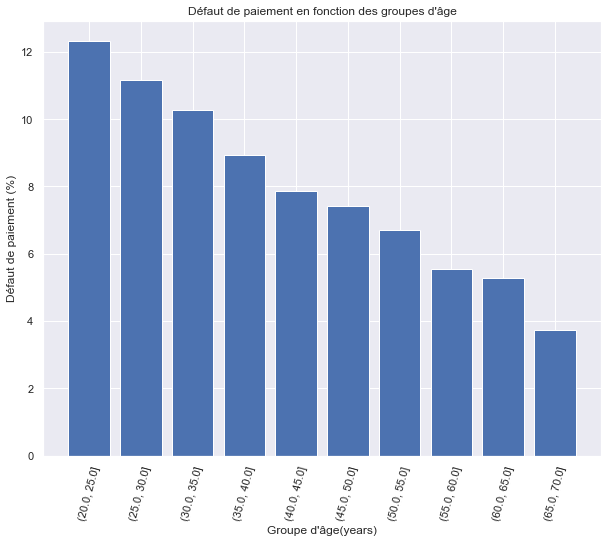

In [107]:
plt.figure(figsize=(10, 8))
# on va représenter la tranche des ages et la moyenne de notret target
plt.bar(age_groups.index.astype(str), 100*age_groups['TARGET'])
plt.xticks(rotation = 75);
plt.xlabel('Groupe d\'âge(years)');
plt.ylabel('Défaut de paiement (%)');
plt.title('Défaut de paiement en fonction des groupes d\'âge');

## Visualisons les différentes relations entre les variables et la variable cible

Définissons une fonction pour afficher les boxplots des relations entre les variables prédictrices et la variable cible

In [108]:
# Fonction de construction pour les boxplots 
def class_box(feature):
    plt.subplots(figsize=(10, 6))
    sns.boxplot(data = train_data, x = train_data[feature], y = train_data.TARGET, sym = "", orient = "h")
    plt.title(f'Boîte à moustache de {feature} par class', fontdict=font_title)
    plt.show()

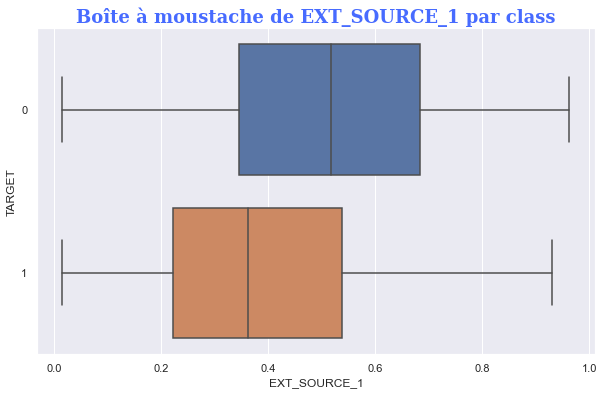

In [109]:
# Appel à la fonction
class_box('EXT_SOURCE_1')

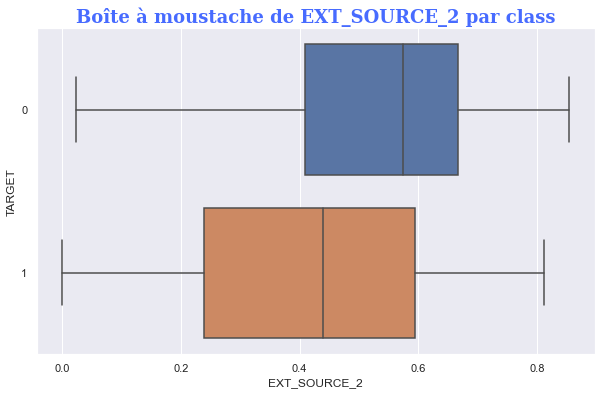

In [110]:
# Appel à la fonction
class_box('EXT_SOURCE_2')

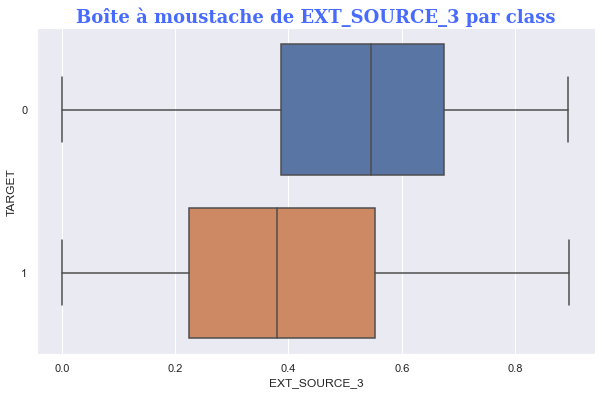

In [111]:
# Appel à la fonction
class_box('EXT_SOURCE_3')

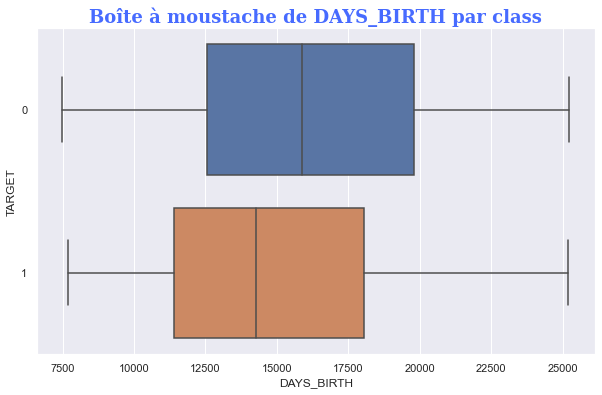

In [112]:
# Appel à la fonction
class_box('DAYS_BIRTH')

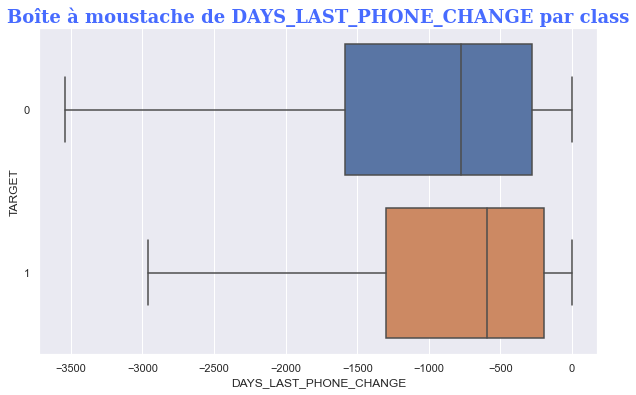

In [113]:
# Appel à la fonction
class_box('DAYS_LAST_PHONE_CHANGE')

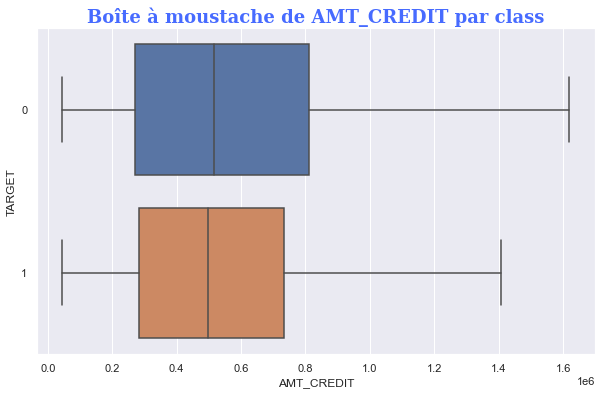

In [114]:
# Appel à la fonction
class_box('AMT_CREDIT')

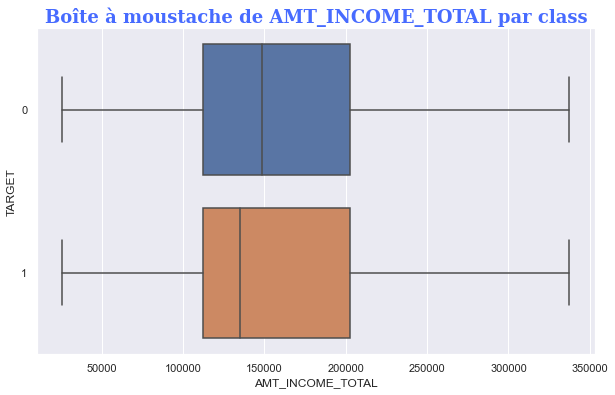

In [115]:
# Appel à la fonction
class_box('AMT_INCOME_TOTAL')

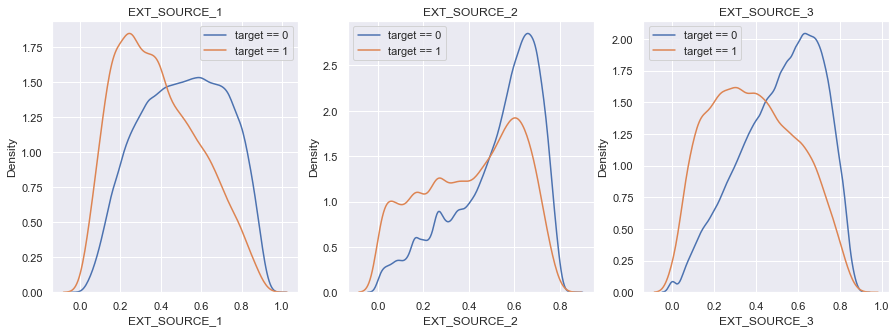

In [116]:
fig,axes=plt.subplots(nrows=1,ncols=3,figsize=(15, 5))

axes[0].title.set_text('EXT_SOURCE_1')
axes[0].set_xlabel('EXT_SOURCE_1')
axes[0].set_ylabel('Density')
sns.kdeplot(train_data.loc[train_data['TARGET'] == 0, 'EXT_SOURCE_1'] , label = 'target == 0',ax=axes[0])
sns.kdeplot(train_data.loc[train_data['TARGET'] == 1, 'EXT_SOURCE_1'] , label = 'target == 1',ax=axes[0])
axes[0].legend()

axes[1].title.set_text('EXT_SOURCE_2')
axes[1].set_xlabel('EXT_SOURCE_2')
axes[1].set_ylabel('Density')
sns.kdeplot(train_data.loc[train_data['TARGET'] == 0, 'EXT_SOURCE_2'] , label = 'target == 0',ax=axes[1])
sns.kdeplot(train_data.loc[train_data['TARGET'] == 1, 'EXT_SOURCE_2'] , label = 'target == 1',ax=axes[1])
axes[1].legend()

axes[2].title.set_text('EXT_SOURCE_3')
axes[2].set_xlabel('EXT_SOURCE_3')
axes[2].set_ylabel('Density')
sns.kdeplot(train_data.loc[train_data['TARGET'] == 0, 'EXT_SOURCE_3'] , label = 'target == 0',ax=axes[2])
sns.kdeplot(train_data.loc[train_data['TARGET'] == 1, 'EXT_SOURCE_3'] , label = 'target == 1',ax=axes[2])
axes[2].legend()

* Source externe 1 < 0,4 alors le client sera par défaut et le client Source externe 1 > 0,4 ​​remboursera, il y a une séparation visible entre deux classes.

* Source externe 2 < 0,5 alors le client sera par défaut et le client Source externe 2> 0,5 remboursera, il y a une séparation visible entre deux classes.

* External source 3< 0.4 alors le client sera par défaut et External source 3 > 0.4 client remboursera, il y a une séparation visible entre deux classes.

Conclusion
EXT_SOURCE_1, EXT_SOURCE_2, EXT_SOURCE_3 ces fonctionnalités sont très utiles

# Feature Engineering

## Feature engineering "nouvelles variables"

Création de nouvells variables en se basant des analyses faites ci dessus

*  Durée de l'emploi par rapport à la durée de vie


*  Combien de crédit une personne a par rapport à combien elle gagne au total


*  Quelle part du revenu d'une personne est sous forme de rente


*  Combien de crédit une personne a-t-elle par rapport à ce qu'elle gagne grâce aux rentes


*  Combien de crédit une personne a par rapport au prix des biens pour lesquels le prêt a été accordé


*  Création des fonctionnalités à partir de fonctionnalités utiles

In [117]:
#le rapport entre les jours d'emploi et lage du client
train_data['DAYS_EMPLOYED_PERCENT'] = train_data['DAYS_EMPLOYED'] / train_data['DAYS_BIRTH']

#pourcentage du revenu de la personne et le montant du crédit
train_data['INCOME_CREDIT_PER'] =  train_data['AMT_INCOME_TOTAL'] / train_data['AMT_CREDIT'] 

#le % entre le montant du crédit et les revenus du client
train_data['ANNUITY_INCOME_PERCENT'] = train_data['AMT_INCOME_TOTAL'] / train_data['AMT_ANNUITY'] 

#le rapport entre le paiement annuel et les revenus du client
train_data['CREDIT_TERM'] = train_data['AMT_ANNUITY'] / train_data['AMT_CREDIT']

# pourcentage credit/par bien
train_data['GOODS_PRICE_CREDIT_PER'] = train_data['AMT_CREDIT'] / train_data['AMT_GOODS_PRICE']

#Montant payé pour la demande de prêt précédente chaque mois décidé par le nombre de jours employés
train_data['GOODS_PRICE_AMT_ANNUITY_PER']=train_data['AMT_ANNUITY'] / train_data['AMT_GOODS_PRICE']
train_data['AMT_CREDIT_DAYS_EMPLOYED_PERC'] = train_data['DAYS_EMPLOYED'] / train_data['AMT_CREDIT']

In [118]:
# ratio = poucentage temps travaillé/ âge
test_data['DAYS_EMPLOYED_PERCENT'] = test_data['DAYS_EMPLOYED'] / test_data['DAYS_BIRTH']

#pourcentage du revenu de la personne et le montant du crédit
test_data['INCOME_CREDIT_PER'] =  test_data['AMT_INCOME_TOTAL'] / test_data['AMT_CREDIT'] 

# pourcentage annuité/revenu
test_data['ANNUITY_INCOME_PERCENT'] = test_data['AMT_INCOME_TOTAL'] / test_data['AMT_ANNUITY'] 

#le rapport entre le paiement annuel et les rrevenus du client
test_data['CREDIT_TERM'] = test_data['AMT_ANNUITY'] / test_data['AMT_CREDIT']

# pourcentage credit/par bien
test_data['GOODS_PRICE_CREDIT_PER'] = test_data['AMT_CREDIT'] / test_data['AMT_GOODS_PRICE']

#Montant payé pour la demande de prêt précédente chaque mois décidé par le nombre de jours employés
test_data['GOODS_PRICE_AMT_ANNUITY_PER']=test_data['AMT_ANNUITY']/test_data['AMT_GOODS_PRICE']
test_data['AMT_CREDIT_DAYS_EMPLOYED_PERC'] = test_data['DAYS_EMPLOYED']/ test_data['AMT_CREDIT']

In [119]:
"""
#Créer des fonctionnalités à partir de fonctionnalités utiles

test_data['EXT_SOURCE_MEAN']=(test_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3']]).mean(axis=1)
    
test_data['EXT_SOURCE_MEDIAN']=(test_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3']]).median(axis=1)
    
test_data['EXT_SOURCE_MIN']=(test_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3']]).min(axis=1)
    
test_data['EXT_SOURCE_MAX']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3']]).max(axis=1)
       """

"\n#Créer des fonctionnalités à partir de fonctionnalités utiles\n\ntest_data['EXT_SOURCE_MEAN']=(test_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',\n       'EXT_SOURCE_3']]).mean(axis=1)\n    \ntest_data['EXT_SOURCE_MEDIAN']=(test_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',\n       'EXT_SOURCE_3']]).median(axis=1)\n    \ntest_data['EXT_SOURCE_MIN']=(test_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',\n       'EXT_SOURCE_3']]).min(axis=1)\n    \ntest_data['EXT_SOURCE_MAX']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',\n       'EXT_SOURCE_3']]).max(axis=1)\n       "

In [120]:
"""
#Créer des fonctionnalités à partir de fonctionnalités utiles

train_data['EXT_SOURCE_MEAN']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3']]).mean(axis=1)
    
train_data['EXT_SOURCE_MEDIAN']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3']]).median(axis=1)
    
train_data['EXT_SOURCE_MIN']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3']]).min(axis=1)
    
train_data['EXT_SOURCE_MAX']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3']]).max(axis=1)
 """      

"\n#Créer des fonctionnalités à partir de fonctionnalités utiles\n\ntrain_data['EXT_SOURCE_MEAN']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',\n       'EXT_SOURCE_3']]).mean(axis=1)\n    \ntrain_data['EXT_SOURCE_MEDIAN']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',\n       'EXT_SOURCE_3']]).median(axis=1)\n    \ntrain_data['EXT_SOURCE_MIN']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',\n       'EXT_SOURCE_3']]).min(axis=1)\n    \ntrain_data['EXT_SOURCE_MAX']=(train_data[['EXT_SOURCE_1', 'EXT_SOURCE_2',\n       'EXT_SOURCE_3']]).max(axis=1)\n "

In [121]:
train_data['Amount_INCOME'] = np.log(train_data['AMT_INCOME_TOTAL'])                    
train_data['Amount_ANNUITY'] = np.log(train_data['AMT_ANNUITY'])                        
train_data['Amount_CREDIT'] = np.log(train_data['AMT_CREDIT'])                       
train_data['Amount_GOODS'] = np.log(train_data['AMT_GOODS_PRICE']) 

In [122]:
test_data['Amount_INCOME'] = np.log(test_data['AMT_INCOME_TOTAL'])                    
test_data['Amount_ANNUITY'] = np.log(test_data['AMT_ANNUITY'])                        
test_data['Amount_CREDIT'] = np.log(test_data['AMT_CREDIT'])                       
test_data['Amount_GOODS'] = np.log(test_data['AMT_GOODS_PRICE']) 

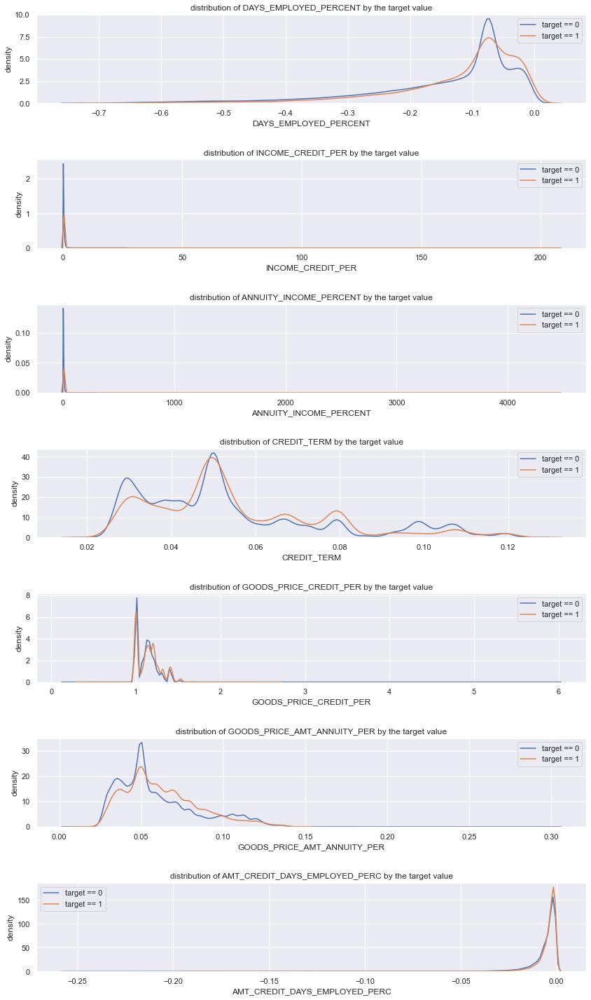

In [123]:
plt.figure(figsize = (12, 20))
# iterate through the new features

for i, feature in enumerate(['DAYS_EMPLOYED_PERCENT', 'INCOME_CREDIT_PER', 
                             'ANNUITY_INCOME_PERCENT', 'CREDIT_TERM', 'GOODS_PRICE_CREDIT_PER',
                           'GOODS_PRICE_AMT_ANNUITY_PER', 'AMT_CREDIT_DAYS_EMPLOYED_PERC'  ]):
    # create a new subplot for each source
    plt.subplot(7, 1, i+1)

    # plot repaid loans
    sns.kdeplot(train_data.loc[train_data['TARGET'] == 0, feature],
               label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(train_data.loc[train_data['TARGET'] == 1, feature],
               label = 'target == 1')
    
    # label the plots
    plt.title('distribution of %s by the target value' % feature)
    plt.xlabel('%s' % feature);
    plt.ylabel('density');
    plt.legend();

plt.tight_layout(h_pad = 2.5)

In [124]:
train_data.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'AMT_INCOME_TOTAL', 'AMT_CREDIT',
       'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE', 'FLAG_EMP_PHONE',
       'FLAG_WORK_PHONE', 'FLAG_PHONE', 'OCCUPATION_TYPE',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_1', 'EXT_SOURCE_2',
       'EXT_SOURCE_3', 'YEARS_BEGINEXPLUATATION_AVG', 'DAYS_LAST_PHONE_CHANGE',
       'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_6', 'DAYS_EMPLOYED_ANOM',
       'DAYS_EMPLOYED_PERCENT', 'INCOME_CREDIT_PER', 'ANNUITY_INCOME_PERCENT',
       'CREDIT_TERM

In [125]:
# Affichage du dataframe aprés features engineering
pd.set_option("display.max_column",58)
train_data.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,OCCUPATION_TYPE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS
0,100002,1,Cash loans,M,N,Y,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,-637.0,-3648.0,-2120,NaN,1,0,1,Laborers,2,2,WEDNESDAY,10,0,0,0,0.083037,0.262949,0.139376,0.9722,-1134.0,1,0,False,-0.067329,0.498036,8.198215,0.060749,1.158397,0.070372,-0.001567,12.218495,10.114579,12.915579,12.768542
1,100003,0,Cash loans,F,N,N,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,-1188.0,-1186.0,-291,NaN,1,0,1,Core staff,1,1,MONDAY,11,0,0,0,0.311267,0.622246,NaN,0.9851,-828.0,1,0,False,-0.070862,0.208736,7.563343,0.027598,1.145199,0.031606,-0.000918,12.506177,10.482864,14.072864,13.937286
2,100004,0,Revolving loans,M,Y,Y,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,-225.0,-4260.0,-2531,26.0,1,1,1,Laborers,2,2,MONDAY,9,0,0,0,NaN,0.555912,0.729567,NaN,-815.0,0,0,False,-0.011814,0.500000,10.000000,0.050000,1.000000,0.050000,-0.001667,11.119883,8.817298,11.813030,11.813030
3,100006,0,Cash loans,F,N,Y,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,-3039.0,-9833.0,-2437,NaN,1,0,0,Laborers,2,2,WEDNESDAY,17,0,0,0,NaN,0.650442,NaN,NaN,-617.0,1,0,False,-0.159905,0.431748,4.547522,0.094941,1.052803,0.099955,-0.009719,11.813030,10.298448,12.652944,12.601487
4,100007,0,Cash loans,M,N,Y,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,19932,-3038.0,-4311.0,-3458,NaN,1,0,0,Core staff,2,2,THURSDAY,11,0,1,1,NaN,0.322738,NaN,NaN,-1106.0,0,0,False,-0.152418,0.236842,5.556699,0.042623,1.000000,0.042623,-0.005922,11.707670,9.992665,13.148031,13.148031


In [126]:
# Affichage du dataframe aprés features engineering
pd.set_option("display.max_column",58)
test_data.head(5)

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,OCCUPATION_TYPE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS
0,100001,Cash loans,F,N,Y,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,19241,-2329.0,-5170.0,-812,NaN,1,0,0,NaN,2,2,TUESDAY,18,0,0,0,0.752614,0.789654,0.159520,0.9732,-1740.0,1,0,False,-0.121044,0.237342,6.565988,0.036147,1.2640,0.045690,-0.004095,11.813030,9.931127,13.251284,13.017003
1,100005,Cash loans,M,N,Y,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,18064,-4469.0,-9118.0,-1623,NaN,1,0,0,Low-skill Laborers,2,2,FRIDAY,9,0,0,0,0.564990,0.291656,0.432962,NaN,0.0,1,0,False,-0.247398,0.444409,5.699482,0.077973,1.2376,0.096500,-0.020061,11.502875,9.762500,12.313886,12.100712
2,100013,Cash loans,M,Y,Y,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,20038,-4458.0,-2175.0,-3503,5.0,1,0,0,Drivers,2,2,MONDAY,14,0,0,0,NaN,0.699787,0.610991,NaN,-856.0,0,0,False,-0.222477,0.305308,2.902102,0.105202,1.0528,0.110757,-0.006721,12.218495,11.153060,13.404928,13.353475
3,100028,Cash loans,F,N,Y,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.026392,13976,-1866.0,-2000.0,-4208,NaN,1,0,1,Sales staff,2,2,WEDNESDAY,11,0,0,0,0.525734,0.509677,0.612704,0.9970,-1805.0,1,0,False,-0.133515,0.200000,6.426145,0.031123,1.0000,0.031123,-0.001185,12.660328,10.799953,14.269766,14.269766
4,100038,Cash loans,M,Y,N,180000.0,625500.0,32067.0,625500.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010032,13040,-2191.0,-4000.0,-4262,16.0,1,1,0,NaN,2,2,FRIDAY,5,0,1,1,0.202145,0.425687,NaN,NaN,-821.0,1,0,False,-0.168021,0.287770,5.613247,0.051266,1.0000,0.051266,-0.003503,12.100712,10.375583,13.346307,13.346307


In [127]:
# mesurer le pourcentage de valeurs manquantes
(train_data.isna().sum()/train_data.shape[0]).sort_values(ascending=True)

SK_ID_CURR                       0.000000
FLAG_WORK_PHONE                  0.000000
FLAG_PHONE                       0.000000
Amount_CREDIT                    0.000000
REGION_RATING_CLIENT_W_CITY      0.000000
WEEKDAY_APPR_PROCESS_START       0.000000
HOUR_APPR_PROCESS_START          0.000000
REG_CITY_NOT_LIVE_CITY           0.000000
FLAG_EMP_PHONE                   0.000000
REG_CITY_NOT_WORK_CITY           0.000000
FLAG_DOCUMENT_3                  0.000000
FLAG_DOCUMENT_6                  0.000000
DAYS_EMPLOYED_ANOM               0.000000
DAYS_EMPLOYED_PERCENT            0.000000
INCOME_CREDIT_PER                0.000000
AMT_CREDIT_DAYS_EMPLOYED_PERC    0.000000
Amount_INCOME                    0.000000
LIVE_CITY_NOT_WORK_CITY          0.000000
DAYS_ID_PUBLISH                  0.000000
REGION_RATING_CLIENT             0.000000
TARGET                           0.000000
AMT_INCOME_TOTAL                 0.000000
AMT_CREDIT                       0.000000
DAYS_REGISTRATION                0

In [128]:
# mesurer le pourcentage de valeurs manquantes
(test_data.isna().sum()/test_data.shape[0]).sort_values(ascending=True)

SK_ID_CURR                       0.000000
FLAG_PHONE                       0.000000
Amount_CREDIT                    0.000000
REGION_RATING_CLIENT_W_CITY      0.000000
WEEKDAY_APPR_PROCESS_START       0.000000
HOUR_APPR_PROCESS_START          0.000000
REG_CITY_NOT_LIVE_CITY           0.000000
REG_CITY_NOT_WORK_CITY           0.000000
LIVE_CITY_NOT_WORK_CITY          0.000000
DAYS_LAST_PHONE_CHANGE           0.000000
FLAG_DOCUMENT_3                  0.000000
FLAG_DOCUMENT_6                  0.000000
DAYS_EMPLOYED_ANOM               0.000000
DAYS_EMPLOYED_PERCENT            0.000000
INCOME_CREDIT_PER                0.000000
GOODS_PRICE_CREDIT_PER           0.000000
AMT_CREDIT_DAYS_EMPLOYED_PERC    0.000000
Amount_INCOME                    0.000000
FLAG_WORK_PHONE                  0.000000
FLAG_EMP_PHONE                   0.000000
REGION_RATING_CLIENT             0.000000
DAYS_ID_PUBLISH                  0.000000
NAME_CONTRACT_TYPE               0.000000
CODE_GENDER                      0

# Analyse exploratoire aprés features engineering

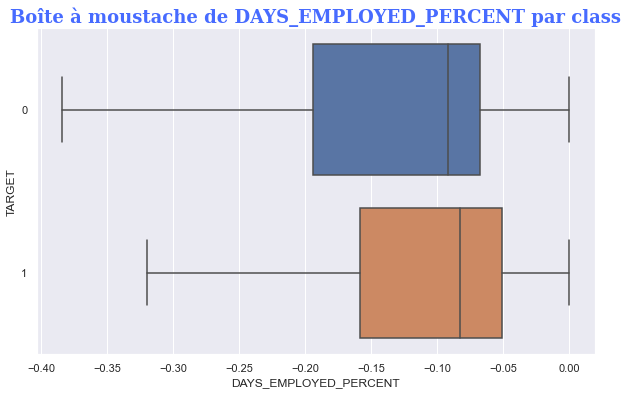

In [129]:
# Appel à la fonction
class_box('DAYS_EMPLOYED_PERCENT')

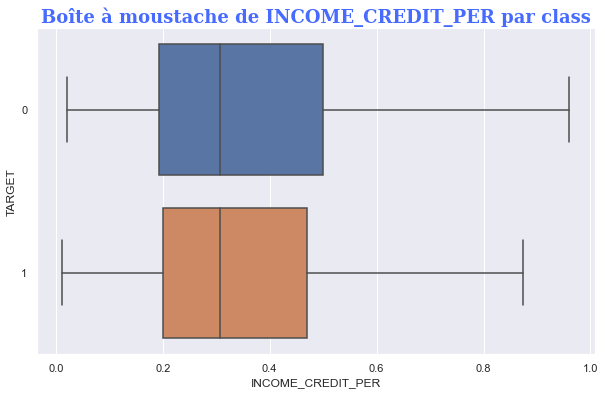

In [130]:
# Appel à la fonction
class_box('INCOME_CREDIT_PER')

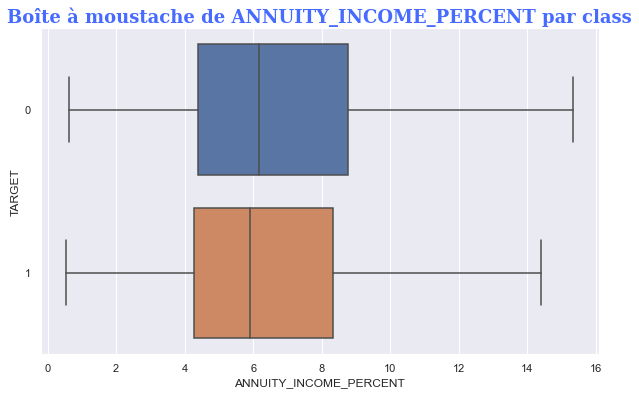

In [131]:
# Appel à la fonction
class_box('ANNUITY_INCOME_PERCENT')

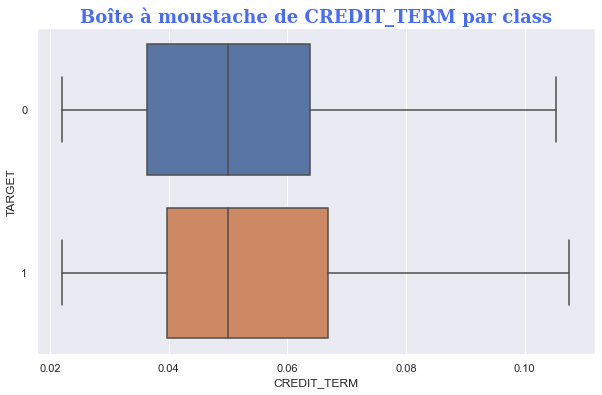

In [132]:
# Appel à la fonction
class_box('CREDIT_TERM')

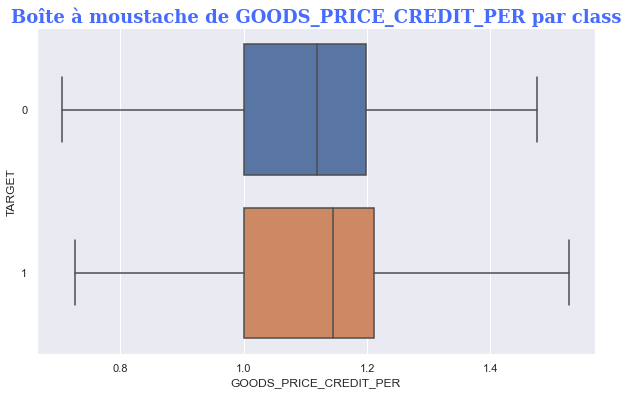

In [133]:
# Appel à la fonction
class_box('GOODS_PRICE_CREDIT_PER')

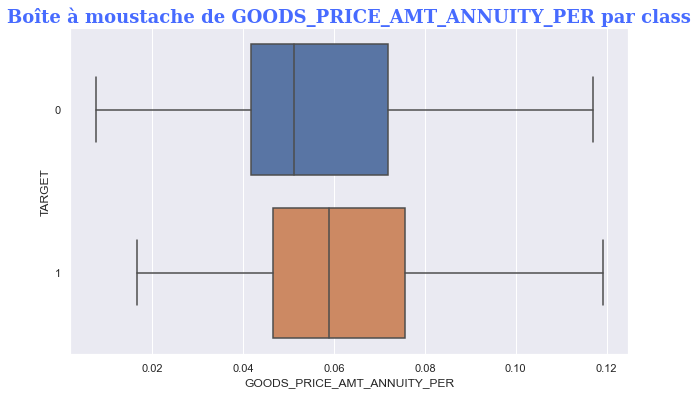

In [134]:
# Appel à la fonction
class_box('GOODS_PRICE_AMT_ANNUITY_PER')

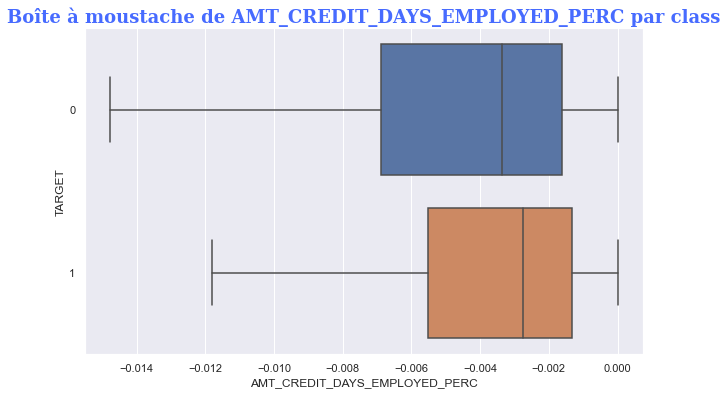

In [135]:
# Appel à la fonction
class_box('AMT_CREDIT_DAYS_EMPLOYED_PERC')

# Gestion des valeurs manquantes

## Détection des outliers

*  Création d'une onction pour détecter les outliers qu'on pourra récupérer par leurs indices ou par leurs valeurs

In [136]:
# Fonction pour détecter les outliers
def detect_outliers(v):
    Q1= np.quantile(v,0.25)
    Q3= np.quantile(v,0.75)
    EIQ= Q3-Q1
    LI=Q1-(EIQ*1.5)
    LS=Q1+(EIQ*1.5)
    i=list(v.index[(v<LI) | (v>LS)])
    val=list(v[i])
    return i, val

In [137]:
# Appel à la fonction par son index
outliers_index = detect_outliers(train_data['DAYS_EMPLOYED'])
outliers_index[0]

[18,
 49,
 51,
 90,
 95,
 98,
 104,
 127,
 141,
 154,
 159,
 162,
 181,
 186,
 191,
 192,
 208,
 235,
 249,
 254,
 259,
 264,
 274,
 285,
 296,
 301,
 326,
 341,
 357,
 374,
 384,
 387,
 388,
 399,
 417,
 444,
 472,
 475,
 485,
 514,
 521,
 541,
 543,
 569,
 582,
 592,
 594,
 615,
 625,
 628,
 644,
 651,
 673,
 720,
 748,
 757,
 772,
 774,
 775,
 781,
 824,
 831,
 834,
 839,
 867,
 885,
 887,
 888,
 890,
 906,
 915,
 929,
 931,
 944,
 948,
 963,
 983,
 1025,
 1042,
 1061,
 1068,
 1077,
 1110,
 1111,
 1112,
 1123,
 1146,
 1164,
 1170,
 1182,
 1209,
 1228,
 1240,
 1264,
 1275,
 1307,
 1316,
 1331,
 1357,
 1378,
 1387,
 1409,
 1418,
 1425,
 1443,
 1468,
 1472,
 1473,
 1481,
 1504,
 1505,
 1511,
 1523,
 1553,
 1570,
 1579,
 1587,
 1593,
 1601,
 1608,
 1609,
 1613,
 1614,
 1636,
 1651,
 1654,
 1674,
 1687,
 1720,
 1732,
 1745,
 1770,
 1771,
 1787,
 1792,
 1806,
 1807,
 1875,
 1884,
 1889,
 1894,
 1902,
 1917,
 1939,
 1948,
 1966,
 1969,
 1973,
 1988,
 1997,
 2019,
 2040,
 2041,
 2043,
 2044

In [138]:
len(outliers_index[0])

23207

In [139]:
# Appel à la fonction par son index
outliers_index = detect_outliers(test_data['DAYS_EMPLOYED'])
outliers_index[0]

[5,
 21,
 55,
 75,
 88,
 107,
 143,
 164,
 177,
 182,
 194,
 196,
 233,
 241,
 242,
 250,
 281,
 289,
 307,
 308,
 312,
 323,
 346,
 353,
 361,
 366,
 377,
 384,
 396,
 409,
 425,
 445,
 448,
 461,
 463,
 465,
 474,
 478,
 479,
 485,
 506,
 508,
 527,
 558,
 562,
 574,
 575,
 579,
 598,
 602,
 641,
 674,
 688,
 690,
 699,
 742,
 744,
 757,
 776,
 784,
 787,
 815,
 829,
 834,
 853,
 872,
 879,
 883,
 889,
 909,
 918,
 950,
 952,
 959,
 977,
 1000,
 1001,
 1004,
 1011,
 1031,
 1051,
 1062,
 1066,
 1071,
 1086,
 1087,
 1093,
 1101,
 1151,
 1168,
 1183,
 1187,
 1190,
 1201,
 1228,
 1298,
 1313,
 1332,
 1335,
 1343,
 1357,
 1376,
 1416,
 1430,
 1435,
 1441,
 1451,
 1454,
 1471,
 1477,
 1490,
 1510,
 1528,
 1539,
 1545,
 1567,
 1568,
 1577,
 1606,
 1639,
 1641,
 1645,
 1668,
 1672,
 1673,
 1676,
 1678,
 1685,
 1691,
 1699,
 1704,
 1708,
 1713,
 1714,
 1715,
 1736,
 1742,
 1746,
 1776,
 1777,
 1787,
 1796,
 1797,
 1804,
 1828,
 1833,
 1861,
 1872,
 1886,
 1903,
 1916,
 1939,
 1942,
 1961,
 19

Vu qu'on a la présence de beaucoup d'outliers , les supprimer nous fera perdre beaucoup di'information. En plus avec les algorithmes de machines leaning qui sont robuste, il y'auras d'inconvenient.

## Choix de la suppression des valeurs manquantes

* Si une colonne contient moins de 5% de valeurs manquantes, nous supprimons ces valeurs manquantes ;


* Si une colonne contient au moins 70% de valeurs manquantes, nous supprimons cette colonne


* Pour le reste des colonnes, nous ferons des imputations

In [140]:
 [col for col in train_data.columns.to_list() if (train_data[col].isna().sum() / train_data.shape[0] > 0 and train_data[col].isna().sum() / train_data.shape[0] <= 0.05)]

['AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'NAME_TYPE_SUITE',
 'EXT_SOURCE_2',
 'DAYS_LAST_PHONE_CHANGE',
 'ANNUITY_INCOME_PERCENT',
 'CREDIT_TERM',
 'GOODS_PRICE_CREDIT_PER',
 'GOODS_PRICE_AMT_ANNUITY_PER',
 'Amount_ANNUITY',
 'Amount_GOODS']

In [141]:
 [col for col in test_data.columns.to_list() if (test_data[col].isna().sum() / test_data.shape[0] > 0 and test_data[col].isna().sum() / test_data.shape[0] <= 0.05)]

['AMT_ANNUITY',
 'NAME_TYPE_SUITE',
 'EXT_SOURCE_2',
 'ANNUITY_INCOME_PERCENT',
 'CREDIT_TERM',
 'GOODS_PRICE_AMT_ANNUITY_PER',
 'Amount_ANNUITY']

In [142]:
# Suppression des Nan 
train_data = train_data.dropna(
    subset = [col for col in train_data.columns.to_list() if (train_data[col].isna().sum() / train_data.shape[0] > 0 and train_data[col].isna().sum() / train_data.shape[0] <= 0.05)])

In [143]:
# Suppression des Nan 
test_data = test_data.dropna(
    subset = [col for col in test_data.columns.to_list() if (test_data[col].isna().sum() / test_data.shape[0] > 0 and test_data[col].isna().sum() / test_data.shape[0] <= 0.05)])

In [144]:
[col for col in train_data.columns.to_list() if (train_data[col].isna().sum() / train_data.shape[0] >= 0.7)]

[]

In [145]:
[col for col in test_data.columns.to_list() if (test_data[col].isna().sum() / test_data.shape[0] >= 0.7)]

[]

In [146]:
# pourcentage de valeurs manquantes
train_data.isna().sum() / train_data.shape[0]

SK_ID_CURR                       0.000000
TARGET                           0.000000
NAME_CONTRACT_TYPE               0.000000
CODE_GENDER                      0.000000
FLAG_OWN_CAR                     0.000000
FLAG_OWN_REALTY                  0.000000
AMT_INCOME_TOTAL                 0.000000
AMT_CREDIT                       0.000000
AMT_ANNUITY                      0.000000
AMT_GOODS_PRICE                  0.000000
NAME_TYPE_SUITE                  0.000000
NAME_INCOME_TYPE                 0.000000
NAME_EDUCATION_TYPE              0.000000
NAME_FAMILY_STATUS               0.000000
NAME_HOUSING_TYPE                0.000000
REGION_POPULATION_RELATIVE       0.000000
DAYS_BIRTH                       0.000000
DAYS_EMPLOYED                    0.000000
DAYS_REGISTRATION                0.000000
DAYS_ID_PUBLISH                  0.000000
OWN_CAR_AGE                      0.659687
FLAG_EMP_PHONE                   0.000000
FLAG_WORK_PHONE                  0.000000
FLAG_PHONE                       0

In [147]:
# pourcentage de valeurs manquantes
test_data.isna().sum() / test_data.shape[0]

SK_ID_CURR                       0.000000
NAME_CONTRACT_TYPE               0.000000
CODE_GENDER                      0.000000
FLAG_OWN_CAR                     0.000000
FLAG_OWN_REALTY                  0.000000
AMT_INCOME_TOTAL                 0.000000
AMT_CREDIT                       0.000000
AMT_ANNUITY                      0.000000
AMT_GOODS_PRICE                  0.000000
NAME_TYPE_SUITE                  0.000000
NAME_INCOME_TYPE                 0.000000
NAME_EDUCATION_TYPE              0.000000
NAME_FAMILY_STATUS               0.000000
NAME_HOUSING_TYPE                0.000000
REGION_POPULATION_RELATIVE       0.000000
DAYS_BIRTH                       0.000000
DAYS_EMPLOYED                    0.000000
DAYS_REGISTRATION                0.000000
DAYS_ID_PUBLISH                  0.000000
OWN_CAR_AGE                      0.662915
FLAG_EMP_PHONE                   0.000000
FLAG_WORK_PHONE                  0.000000
FLAG_PHONE                       0.000000
OCCUPATION_TYPE                  0

In [148]:
data1 = train_data.copy()
data2 = test_data.copy()

In [149]:
data1.shape

(305539, 51)

In [150]:
# Sauvegarder
data1.to_csv('data_preprocessing1_train.csv', index=False)

data2.to_csv('data_preprocessing1_test.csv', index=False)

## Imputation des valeurs manquantes

*  Remplacement des valeurs manquantes en faisant des imputations par la moyenne, la 
médiane, ...etc de la variable contenant ces valeurs manquantes. Il existe également 
d'autres méthodes d'imputation plus ou moins sophistiquées comme la méthode des k 
plus proches voisins (KNN).


In [151]:
# Imputation par la mediane pour les variables numériques
#train_data['TARGET'] = train_data['TARGET'].fillna(train_data['TARGET'].median())

train_data['EXT_SOURCE_3'] = train_data['EXT_SOURCE_3'].fillna(train_data['EXT_SOURCE_3'].median())

train_data['EXT_SOURCE_1'] = train_data['EXT_SOURCE_1'].fillna(train_data['EXT_SOURCE_1'].median())

train_data['YEARS_BEGINEXPLUATATION_AVG'] = train_data['YEARS_BEGINEXPLUATATION_AVG'].fillna(train_data['YEARS_BEGINEXPLUATATION_AVG'].median())

train_data['OWN_CAR_AGE'] = train_data['OWN_CAR_AGE'].fillna(train_data['OWN_CAR_AGE'].median())


In [152]:
# Imputation par la mediane pour les variables numériques

test_data['EXT_SOURCE_3'] = test_data['EXT_SOURCE_3'].fillna(test_data['EXT_SOURCE_3'].median())

test_data['EXT_SOURCE_1'] = test_data['EXT_SOURCE_1'].fillna(test_data['EXT_SOURCE_1'].median())

test_data['YEARS_BEGINEXPLUATATION_AVG'] = test_data['YEARS_BEGINEXPLUATATION_AVG'].fillna(test_data['YEARS_BEGINEXPLUATATION_AVG'].median())

test_data['OWN_CAR_AGE'] = test_data['OWN_CAR_AGE'].fillna(test_data['OWN_CAR_AGE'].median())

In [153]:
# Imputation des valeurs manquantes par le mode pour les variables catégorielles
for col in ['OCCUPATION_TYPE']:
    train_data[col].fillna(train_data[col].mode()[0], inplace=True)

In [154]:
# Imputation des valeurs manquantes par le mode pour les variables catégorielles
for col in ['OCCUPATION_TYPE']:
    test_data[col].fillna(test_data[col].mode()[0], inplace=True)

In [155]:
# Vérification aprés impuitation
train_data.isna().sum()

SK_ID_CURR                       0
TARGET                           0
NAME_CONTRACT_TYPE               0
CODE_GENDER                      0
FLAG_OWN_CAR                     0
FLAG_OWN_REALTY                  0
AMT_INCOME_TOTAL                 0
AMT_CREDIT                       0
AMT_ANNUITY                      0
AMT_GOODS_PRICE                  0
NAME_TYPE_SUITE                  0
NAME_INCOME_TYPE                 0
NAME_EDUCATION_TYPE              0
NAME_FAMILY_STATUS               0
NAME_HOUSING_TYPE                0
REGION_POPULATION_RELATIVE       0
DAYS_BIRTH                       0
DAYS_EMPLOYED                    0
DAYS_REGISTRATION                0
DAYS_ID_PUBLISH                  0
OWN_CAR_AGE                      0
FLAG_EMP_PHONE                   0
FLAG_WORK_PHONE                  0
FLAG_PHONE                       0
OCCUPATION_TYPE                  0
REGION_RATING_CLIENT             0
REGION_RATING_CLIENT_W_CITY      0
WEEKDAY_APPR_PROCESS_START       0
HOUR_APPR_PROCESS_ST

In [156]:
# Vérification aprés impuitation
test_data.isna().sum()

SK_ID_CURR                       0
NAME_CONTRACT_TYPE               0
CODE_GENDER                      0
FLAG_OWN_CAR                     0
FLAG_OWN_REALTY                  0
AMT_INCOME_TOTAL                 0
AMT_CREDIT                       0
AMT_ANNUITY                      0
AMT_GOODS_PRICE                  0
NAME_TYPE_SUITE                  0
NAME_INCOME_TYPE                 0
NAME_EDUCATION_TYPE              0
NAME_FAMILY_STATUS               0
NAME_HOUSING_TYPE                0
REGION_POPULATION_RELATIVE       0
DAYS_BIRTH                       0
DAYS_EMPLOYED                    0
DAYS_REGISTRATION                0
DAYS_ID_PUBLISH                  0
OWN_CAR_AGE                      0
FLAG_EMP_PHONE                   0
FLAG_WORK_PHONE                  0
FLAG_PHONE                       0
OCCUPATION_TYPE                  0
REGION_RATING_CLIENT             0
REGION_RATING_CLIENT_W_CITY      0
WEEKDAY_APPR_PROCESS_START       0
HOUR_APPR_PROCESS_START          0
REG_CITY_NOT_LIVE_CI

<class 'pandas.core.frame.DataFrame'>
Int64Index: 305539 entries, 0 to 307510
Data columns (total 51 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   SK_ID_CURR                     305539 non-null  int64  
 1   TARGET                         305539 non-null  int64  
 2   NAME_CONTRACT_TYPE             305539 non-null  object 
 3   CODE_GENDER                    305539 non-null  object 
 4   FLAG_OWN_CAR                   305539 non-null  object 
 5   FLAG_OWN_REALTY                305539 non-null  object 
 6   AMT_INCOME_TOTAL               305539 non-null  float64
 7   AMT_CREDIT                     305539 non-null  float64
 8   AMT_ANNUITY                    305539 non-null  float64
 9   AMT_GOODS_PRICE                305539 non-null  float64
 10  NAME_TYPE_SUITE                305539 non-null  object 
 11  NAME_INCOME_TYPE               305539 non-null  object 
 12  NAME_EDUCATION_TYPE           

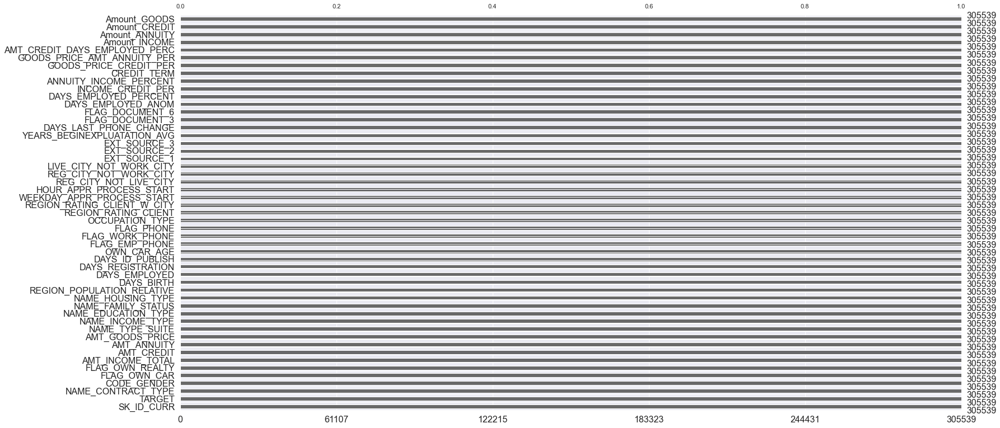

In [157]:
# Appel à la fonction
data_quality_assment(train_data)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 47801 entries, 0 to 48743
Data columns (total 50 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   SK_ID_CURR                     47801 non-null  int64  
 1   NAME_CONTRACT_TYPE             47801 non-null  object 
 2   CODE_GENDER                    47801 non-null  object 
 3   FLAG_OWN_CAR                   47801 non-null  object 
 4   FLAG_OWN_REALTY                47801 non-null  object 
 5   AMT_INCOME_TOTAL               47801 non-null  float64
 6   AMT_CREDIT                     47801 non-null  float64
 7   AMT_ANNUITY                    47801 non-null  float64
 8   AMT_GOODS_PRICE                47801 non-null  float64
 9   NAME_TYPE_SUITE                47801 non-null  object 
 10  NAME_INCOME_TYPE               47801 non-null  object 
 11  NAME_EDUCATION_TYPE            47801 non-null  object 
 12  NAME_FAMILY_STATUS             47801 non-null 

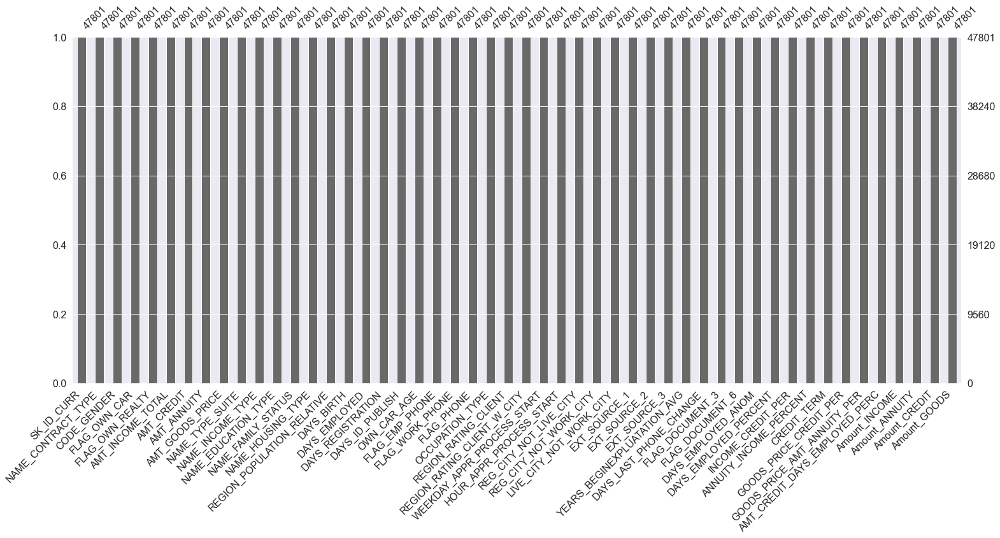

In [158]:
# Appel à la fonction
data_quality_assment(test_data)

In [159]:
# Appel à la fonction
describe_cat_columns(train_data)

NAME_CONTRACT_TYPE
Categories and Count:
Cash loans         276612
Revolving loans     28927


CODE_GENDER
Categories and Count:
F    201130
M    104409


FLAG_OWN_CAR
Categories and Count:
N    201558
Y    103981


FLAG_OWN_REALTY
Categories and Count:
Y    212371
N     93168


NAME_TYPE_SUITE
Categories and Count:
Unaccompanied      247991
Family              40059
Spouse, partner     11338
Children             3255
Other_B              1762
Other_A               865
Group of people       269


NAME_INCOME_TYPE
Categories and Count:
Working                 157808
Commercial associate     71112
Pensioner                55009
State servant            21561
Unemployed                  22
Student                     17
Businessman                 10


NAME_EDUCATION_TYPE
Categories and Count:
Secondary / secondary special    217095
Higher education                  74268
Incomplete higher                 10218
Lower secondary                    3795
Academic degree                     16

In [160]:
# Appel à la fonction
describe_cat_columns(test_data)

NAME_CONTRACT_TYPE
Categories and Count:
Cash loans         47363
Revolving loans      438


CODE_GENDER
Categories and Count:
F    32037
M    15764


FLAG_OWN_CAR
Categories and Count:
N    31688
Y    16113


FLAG_OWN_REALTY
Categories and Count:
Y    32878
N    14923


NAME_TYPE_SUITE
Categories and Count:
Unaccompanied      39699
Family              5877
Spouse, partner     1448
Children             408
Other_B              211
Other_A              109
Group of people       49


NAME_INCOME_TYPE
Categories and Count:
Working                 24110
Commercial associate    11173
Pensioner                9057
State servant            3457
Student                     2
Businessman                 1
Unemployed                  1


NAME_EDUCATION_TYPE
Categories and Count:
Secondary / secondary special    33341
Higher education                 12264
Incomplete higher                 1688
Lower secondary                    468
Academic degree                     40


NAME_FAMILY_STATUS
Cate

In [161]:
# description statistique
train_data.describe()

,SK_ID_CURR,TARGET,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS
count,305539.000000,305539.000000,3.055390e+05,3.055390e+05,305539.000000,3.055390e+05,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,3.055390e+05,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000,305539.000000
mean,278173.351775,0.080844,1.688328e+05,5.990803e+05,27131.815364,5.382172e+05,0.020863,16039.604332,-2252.900507,-4986.759317,-2994.435012,10.044911,0.819876,0.199081,0.280730,2.052697,2.031692,12.062548,0.078164,0.230465,0.179578,0.504321,5.143498e-01,0.515686,0.979619,-964.725177,0.710571,0.087776,-0.142433,0.399772,7.347799,0.053732,1.122889,0.059954,-0.005896,11.909505,10.068651,13.070371,12.960231
std,102784.460818,0.272596,2.377504e+05,4.020907e+05,14494.710118,3.690435e+05,0.013830,4362.287031,2137.014005,3521.760864,1509.544474,7.121612,0.384292,0.399310,0.449357,0.509146,0.502832,3.266231,0.268429,0.421131,0.383836,0.139447,1.910908e-01,0.174758,0.042442,826.769490,0.453498,0.282969,0.124923,0.509005,9.463337,0.022485,0.123931,0.024651,0.008677,0.488794,0.545660,0.715135,0.715536
min,100002.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,7489.000000,-17912.000000,-24672.000000,-7197.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.014568,8.173617e-08,0.000527,0.000000,-4292.000000,0.000000,0.000000,-0.728811,0.011801,0.533059,0.022073,0.150000,0.007500,-0.256178,10.152299,7.387400,10.714418,10.609057
25%,189144.000000,0.000000,1.125000e+05,2.700000e+05,16564.500000,2.385000e+05,0.010006,12418.000000,-2762.000000,-7479.000000,-4299.000000,9.000000,1.000000,0.000000,0.000000,2.000000,2.000000,10.000000,0.000000,0.000000,0.000000,0.505998,3.923271e-01,0.417100,0.981600,-1571.000000,0.000000,0.000000,-0.191124,0.193738,4.361925,0.036926,1.000000,0.042364,-0.006807,11.630709,9.715017,12.506177,12.382125
50%,278191.000000,0.000000,1.485000e+05,5.146020e+05,24939.000000,4.500000e+05,0.018850,15755.000000,-1648.000000,-4506.000000,-3255.000000,9.000000,1.000000,0.000000,0.000000,2.000000,2.000000,12.000000,0.000000,0.000000,0.000000,0.505998,5.659399e-01,0.535276,0.981600,-759.000000,1.000000,0.000000,-0.091104,0.306122,6.136475,0.050000,1.118800,0.051402,-0.003304,11.908340,10.124188,13.151149,13.017003
75%,367143.500000,0.000000,2.025000e+05,8.086500e+05,34620.750000,6.795000e+05,0.028663,19682.000000,-934.000000,-2012.000000,-1720.000000,9.000000,1.000000,0.000000,1.000000,2.000000,2.000000,14.000000,0.000000,0.000000,0.000000,0.505998,6.636171e-01,0.636376,0.982100,-276.000000,1.000000,0.000000,-0.066875,0.495376,8.707009,0.064074,1.198000,0.072200,-0.001595,12.218495,10.452208,13.603121,13.429113
max,456255.000000,1.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,25229.000000,0.000000,0.000000,0.000000,91.000000,1.000000,1.000000,1.000000,3.000000,3.000000,23.000000,1.000000,1.000000,1.000000,0.962693,8.549997e-01,0.896010,1.000000,0.000000,1.000000,1.000000,0.000000,208.003328,4466.586497,0.124430,6.00000

In [162]:
# description statistique
test_data.describe()

,SK_ID_CURR,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS
count,47801.000000,4.780100e+04,4.780100e+04,47801.000000,4.780100e+04,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.00000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000,47801.000000
mean,277768.288258,1.784140e+05,5.168996e+05,29433.310914,4.628645e+05,0.021222,16060.391582,-2341.567478,-4968.892157,-3050.479216,9.939980,0.810485,0.206356,0.264137,2.038221,2.012678,12.01092,0.077551,0.224933,0.174390,0.503302,0.517809,0.503182,0.980179,-1078.038535,0.786636,0.087153,-0.148243,0.489113,7.225144,0.066616,1.131566,0.074806,-0.007070,11.974006,10.145402,12.921744,12.803930
std,103167.039266,1.014004e+05,3.653415e+05,16009.849807,3.366665e+05,0.014436,4322.014263,2096.293638,3553.341896,1569.127176,6.779774,0.391921,0.404693,0.440877,0.523050,0.516107,3.27865,0.267466,0.417542,0.379448,0.156098,0.181379,0.172049,0.035185,878.444169,0.409687,0.282062,0.123749,0.407546,4.718079,0.024556,0.124618,0.026774,0.009856,0.476535,0.554937,0.708652,0.715521
min,100001.000000,2.700000e+04,4.500000e+04,2295.000000,4.500000e+04,0.000253,7338.000000,-17463.000000,-23722.000000,-6348.000000,0.000000,0.000000,0.000000,0.000000,1.000000,-1.000000,0.00000,0.000000,0.000000,0.000000,0.013458,0.000008,0.000527,0.000000,-4361.000000,0.000000,0.000000,-0.721157,0.032846,0.493897,0.031037,0.650000,0.031037,-0.285089,10.203592,7.738488,10.714418,10.714418
25%,188561.000000,1.125000e+05,2.606400e+05,17973.000000,2.250000e+05,0.010006,12494.000000,-2912.000000,-7466.000000,-4447.000000,9.000000,1.000000,0.000000,0.000000,2.000000,2.000000,10.00000,0.000000,0.000000,0.000000,0.465297,0.408015,0.399676,0.981100,-1767.000000,1.000000,0.000000,-0.199656,0.248076,4.347826,0.048536,1.000000,0.051471,-0.008084,11.630709,9.796626,12.470895,12.323856
50%,277566.000000,1.575000e+05,4.500000e+05,26203.500000,4.005000e+05,0.018850,15779.000000,-1765.000000,-4493.000000,-3229.000000,9.000000,1.000000,0.000000,0.000000,2.000000,2.000000,12.00000,0.000000,0.000000,0.000000,0.506442,0.558567,0.519097,0.981600,-864.000000,1.000000,0.000000,-0.097729,0.375000,6.025548,0.061420,1.132000,0.070611,-0.004092,11.967181,10.173648,13.017003,12.900469
75%,367545.000000,2.250000e+05,6.750000e+05,37390.500000,6.300000e+05,0.028663,19619.000000,-1046.000000,-1901.000000,-1705.000000,9.000000,1.000000,0.000000,1.000000,2.000000,2.000000,14.00000,0.000000,0.000000,0.000000,0.550933,0.658320,0.624615,0.982100,-364.000000,1.000000,0.000000,-0.072832,0.589727,8.599274,0.079442,1.211200,0.096017,-0.002065,12.323856,10.529172,13.422468,13.353475
max,456250.000000,4.410000e+06,2.245500e+06,180576.000000,2.245500e+06,0.072508,25195.000000,-1.000000,0.000000,0.000000,74.000000,1.000000,1.000000,1.000000,3.000000,3.000000,23.00000,1.000000,1.000000,1.000000,0.939145,0.855000,0.882530,1.000000,0.000000,1.000000,1.000000,-0.000081,10.810811,174.520070,0.124430,4.000000,0.200000,-0.000001,15.299385,12.103907,14.624439,14.624439


In [163]:
# Sauvegarde
train_data.to_csv('data_preprocessing2_train.csv', index=False)
test_data.to_csv('data_preprocessing2_test.csv', index=False)

# Encodage des variables catégorielles

In [164]:
from sklearn.preprocessing import OneHotEncoder

In [165]:
data_clean1 = train_data.copy()
data_clean2 = test_data.copy()

In [166]:
data_clean1.shape

(305539, 51)

### Sauvegarde de quelques bases de données

In [196]:
data_clean2['CODE_GENDER'].to_csv('Genre.csv', index = False)
data_clean2['NAME_EDUCATION_TYPE'].to_csv('Education.csv', index = False)
data_clean2['OCCUPATION_TYPE'].to_csv('Occupation.csv', index = False)
data_clean2['NAME_FAMILY_STATUS'].to_csv('Family.csv', index = False)
data_clean2['AMT_INCOME_TOTAL'].to_csv('Income.csv', index = False)
data_clean2['Amount_INCOME'].to_csv('Amount_Income.csv', index = False)

## Encodage des variables binaires

In [167]:
data_clean1['CODE_GENDER'] = data_clean1['CODE_GENDER'].apply(lambda row : 1 if row == "F" else 0)
data_clean1['FLAG_OWN_CAR'] = data_clean1['FLAG_OWN_CAR'].apply(lambda row : 1 if row == "Y" else 0)
data_clean1['FLAG_OWN_REALTY'] = data_clean1['FLAG_OWN_REALTY'].apply(lambda row : 1 if row == "Y" else 0)
data_clean1['NAME_CONTRACT_TYPE'] = data_clean1['NAME_CONTRACT_TYPE'].apply(lambda row : 1 if row == "Cash loans" else 0)
data_clean1["DAYS_EMPLOYED_ANOM"] = data_clean1["DAYS_EMPLOYED_ANOM"].apply(lambda row : 1 if row == "F" else 0)

In [168]:
data_clean2['CODE_GENDER'] = data_clean2['CODE_GENDER'].apply(lambda row : 1 if row == "F" else 0)
data_clean2['FLAG_OWN_CAR'] = data_clean2['FLAG_OWN_CAR'].apply(lambda row : 1 if row == "Y" else 0)
data_clean2['FLAG_OWN_REALTY'] = data_clean2['FLAG_OWN_REALTY'].apply(lambda row : 1 if row == "Y" else 0)
data_clean2['NAME_CONTRACT_TYPE'] = data_clean2['NAME_CONTRACT_TYPE'].apply(lambda row : 1 if row == "Cash loans" else 0)
data_clean2["DAYS_EMPLOYED_ANOM"] = data_clean2["DAYS_EMPLOYED_ANOM"].apply(lambda row : 1 if row == "F" else 0)

##  Encodages des variables catégorielles restantes

In [169]:
# Séparation des variables numériques en list
data_num_train = data_clean1.select_dtypes(include=["int64","float"]).columns.to_list()
data_num_train

['SK_ID_CURR',
 'TARGET',
 'NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_PHONE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_6',
 'DAYS_EMPLOYED_ANOM',
 'DAYS_EMPLOYED_PERCENT',
 'INCOME_CREDIT_PER',
 'ANNUITY_INCOME_PERCENT',
 'CREDIT_TERM',
 'GOODS_PRICE_CREDIT_PER',
 'GOODS_PRICE_AMT_ANNUITY_PER',
 'AMT_CREDIT_DAYS_EMPLOYED_PERC',
 'Amount_INCOME',
 'Amount_ANNUITY',
 'Amount_CREDIT',
 'Amount_GOODS']

In [170]:
# Séparation des variables numériques en list
data_num_test = data_clean2.select_dtypes(include=["int64","float"]).columns.to_list()
data_num_test

['SK_ID_CURR',
 'NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_PHONE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'YEARS_BEGINEXPLUATATION_AVG',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_6',
 'DAYS_EMPLOYED_ANOM',
 'DAYS_EMPLOYED_PERCENT',
 'INCOME_CREDIT_PER',
 'ANNUITY_INCOME_PERCENT',
 'CREDIT_TERM',
 'GOODS_PRICE_CREDIT_PER',
 'GOODS_PRICE_AMT_ANNUITY_PER',
 'AMT_CREDIT_DAYS_EMPLOYED_PERC',
 'Amount_INCOME',
 'Amount_ANNUITY',
 'Amount_CREDIT',
 'Amount_GOODS']

In [171]:
# Séparation des variables catégorielles en list
data_cat_train = data_clean1.select_dtypes("object").columns.to_list()
data_cat_train

['NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START']

In [172]:
# Séparation des variables catégorielles en list
data_cat_test = data_clean2.select_dtypes("object").columns.to_list()
data_cat_test

['NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START']

### pandas.get_dummies(...)

In [173]:
# Application de la fonction 
dummy_data_train = pd.get_dummies(data_clean1[data_cat_train], drop_first = True)
print(dummy_data_train.shape)
dummy_data_train.head(5)

(305539, 48)


,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY
0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
2,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [174]:
# Application de la fonction 
dummy_data_test = pd.get_dummies(data_clean2[data_cat_test], drop_first = True)
print(dummy_data_test.shape)
dummy_data_test.head(5)

(47801, 48)


,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY
0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
4,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0


### Fusion des deux datasets

In [175]:
# Concaténation
new_data_train = pd.concat([data_clean1, dummy_data_train], axis = 1)
new_data_train.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,OCCUPATION_TYPE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY
0,100002,1,1,0,0,1,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,-637.0,-3648.0,-2120,9.0,1,0,1,Laborers,2,2,WEDNESDAY,10,0,0,0,0.083037,0.262949,0.139376,0.9722,-1134.0,1,0,0,-0.067329,0.498036,8.198215,0.060749,1.158397,0.070372,-0.001567,12.218495,10.114579,12.915579,12.768542,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,100003,0,1,1,0,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,-1188.0,-1186.0,-291,9.0,1,0,1,Core staff,1,1,MONDAY,11,0,0,0,0.311267,0.622246,0.535276,0.9851,-828.0,1,0,0,-0.070862,0.208736,7.563343,0.027598,1.145199,0.031606,-0.000918,12.506177,10.482864,14.072864,13.937286,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
2,100004,0,0,0,1,1,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,-225.0,-4260.0,-2531,26.0,1,1,1,Laborers,2,2,MONDAY,9,0,0,0,0.505998,0.555912,0.729567,0.9816,-815.0,0,0,0,-0.011814,0.500000,10.000000,0.050000,1.000000,0.050000,-0.001667,11.119883,8.817298,11.813030,11.813030,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,100006,0,1,1,0,1,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,-3039.0,-9833.0,-2437,9.0,1,0,0,Laborers,2

In [176]:
# Concaténation
new_data_test = pd.concat([data_clean2, dummy_data_test], axis = 1)
new_data_test.head(5)

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,OCCUPATION_TYPE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY
0,100001,1,1,0,1,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,19241,-2329.0,-5170.0,-812,9.0,1,0,0,Laborers,2,2,TUESDAY,18,0,0,0,0.752614,0.789654,0.159520,0.9732,-1740.0,1,0,0,-0.121044,0.237342,6.565988,0.036147,1.2640,0.045690,-0.004095,11.813030,9.931127,13.251284,13.017003,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,100005,1,0,0,1,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,18064,-4469.0,-9118.0,-1623,9.0,1,0,0,Low-skill Laborers,2,2,FRIDAY,9,0,0,0,0.564990,0.291656,0.432962,0.9816,0.0,1,0,0,-0.247398,0.444409,5.699482,0.077973,1.2376,0.096500,-0.020061,11.502875,9.762500,12.313886,12.100712,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,100028,1,1,0,1,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.026392,13976,-1866.0,-2000.0,-4208,9.0,1,0,1,Sales staff,2,2,WEDNESDAY,11,0,0,0,0.525734,0.509677,0.612704,0.9970,-1805.0,1,0,0,-0.133515,0.200000,6.426145,0.031123,1.0000,0.031123,-0.001185,12.660328,10.799953,14.269766,14.269766,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
4,100038,1,0,1,0,180000.0,625500.0,32067.0,625500.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010032,13040,-2191.0,-4000.0,-4262,16.0,1,1,0,Laborers,2,2,FRIDAY,5,0,1,1,0.202145,0.425687,0.519

### Suppression des variables originelles

In [177]:
# dataset final
final_data_train = new_data_train.drop(data_cat_train, axis = 1)
final_data_train.head(5) 

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY
0,100002,1,1,0,0,1,202500.0,406597.5,24700.5,351000.0,0.018801,9461,-637.0,-3648.0,-2120,9.0,1,0,1,2,2,10,0,0,0,0.083037,0.262949,0.139376,0.9722,-1134.0,1,0,0,-0.067329,0.498036,8.198215,0.060749,1.158397,0.070372,-0.001567,12.218495,10.114579,12.915579,12.768542,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,100003,0,1,1,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,16765,-1188.0,-1186.0,-291,9.0,1,0,1,1,1,11,0,0,0,0.311267,0.622246,0.535276,0.9851,-828.0,1,0,0,-0.070862,0.208736,7.563343,0.027598,1.145199,0.031606,-0.000918,12.506177,10.482864,14.072864,13.937286,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
2,100004,0,0,0,1,1,67500.0,135000.0,6750.0,135000.0,0.010032,19046,-225.0,-4260.0,-2531,26.0,1,1,1,2,2,9,0,0,0,0.505998,0.555912,0.729567,0.9816,-815.0,0,0,0,-0.011814,0.500000,10.000000,0.050000,1.000000,0.050000,-0.001667,11.119883,8.817298,11.813030,11.813030,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,100006,0,1,1,0,1,135000.0,312682.5,29686.5,297000.0,0.008019,19005,-3039.0,-9833.0,-2437,9.0,1,0,0,2,2,17,0,0,0,0.505998,0.650442,0.535276,0.9816,-617.0,1,0,0,-0.159905,0.431748,4.547522,0.094941,1.052803,0.099955,-0.009719,11.813030,10.298448,12.652944,12.601487,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,100007,0,1,0,0,1,121500.0,513000.0,21865.5,513000.0,0.028663,19932,-3038.0,-4311.0,-3458,9.0,1,0,0,2,2,11,0,1,1,0.505998,0.322738,0.535276,0.9816,-1106.0,0,0,0,-0.152418,0.236842,5.556699,0.042623,1.000000,0.042623,-0.005922,11.707670,9.992665,13.148031,13.148031,

In [178]:
# dataset final
final_data_test = new_data_test.drop(data_cat_test, axis = 1)
final_data_test.head(5)

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY
0,100001,1,1,0,1,135000.0,568800.0,20560.5,450000.0,0.018850,19241,-2329.0,-5170.0,-812,9.0,1,0,0,2,2,18,0,0,0,0.752614,0.789654,0.159520,0.9732,-1740.0,1,0,0,-0.121044,0.237342,6.565988,0.036147,1.2640,0.045690,-0.004095,11.813030,9.931127,13.251284,13.017003,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,100005,1,0,0,1,99000.0,222768.0,17370.0,180000.0,0.035792,18064,-4469.0,-9118.0,-1623,9.0,1,0,0,2,2,9,0,0,0,0.564990,0.291656,0.432962,0.9816,0.0,1,0,0,-0.247398,0.444409,5.699482,0.077973,1.2376,0.096500,-0.020061,11.502875,9.762500,12.313886,12.100712,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,100028,1,1,0,1,315000.0,1575000.0,49018.5,1575000.0,0.026392,13976,-1866.0,-2000.0,-4208,9.0,1,0,1,2,2,11,0,0,0,0.525734,0.509677,0.612704,0.9970,-1805.0,1,0,0,-0.133515,0.200000,6.426145,0.031123,1.0000,0.031123,-0.001185,12.660328,10.799953,14.269766,14.269766,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
4,100038,1,0,1,0,180000.0,625500.0,32067.0,625500.0,0.010032,13040,-2191.0,-4000.0,-4262,16.0,1,1,0,2,2,5,0,1,1,0.202145,0.425687,0.519097,0.9816,-821.0,1,0,0,-0.168021,0.287770,5.613247,0.051266,1.0000,0.051266,-0.003503,12.100712,10.375583,13.346307,13.346307,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,100042,1,1,1,1,270000.0,959688.0,34600.5,810000.0,0.025164,18604,-12009.0,-6116.0,-2027,10.0,1,0,1,2,2,15,0,0,0,0.506442,0.628904,0.392774,0.9821,-1705.0,0,0,0,-0.645506,0.281341,7.803355,0.036054,1.1848,0.042717,-0.012513,12.506177,10.451623,13.774364,13.604790,0,0,0,0,0,1,0,0,1,0,0,0,0

In [179]:
final_data_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 305539 entries, 0 to 307510
Data columns (total 92 columns):
 #   Column                                             Non-Null Count   Dtype  
---  ------                                             --------------   -----  
 0   SK_ID_CURR                                         305539 non-null  int64  
 1   TARGET                                             305539 non-null  int64  
 2   NAME_CONTRACT_TYPE                                 305539 non-null  int64  
 3   CODE_GENDER                                        305539 non-null  int64  
 4   FLAG_OWN_CAR                                       305539 non-null  int64  
 5   FLAG_OWN_REALTY                                    305539 non-null  int64  
 6   AMT_INCOME_TOTAL                                   305539 non-null  float64
 7   AMT_CREDIT                                         305539 non-null  float64
 8   AMT_ANNUITY                                        305539 non-null  float6

In [180]:
final_data_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 47801 entries, 0 to 48743
Data columns (total 91 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   SK_ID_CURR                                         47801 non-null  int64  
 1   NAME_CONTRACT_TYPE                                 47801 non-null  int64  
 2   CODE_GENDER                                        47801 non-null  int64  
 3   FLAG_OWN_CAR                                       47801 non-null  int64  
 4   FLAG_OWN_REALTY                                    47801 non-null  int64  
 5   AMT_INCOME_TOTAL                                   47801 non-null  float64
 6   AMT_CREDIT                                         47801 non-null  float64
 7   AMT_ANNUITY                                        47801 non-null  float64
 8   AMT_GOODS_PRICE                                    47801 non-null  float64
 9   REGION

In [181]:
final_data_train.shape , final_data_test.shape

((305539, 92), (47801, 91))

In [182]:
final_data_train.head(5)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY
0,100002,1,1,0,0,1,202500.0,406597.5,24700.5,351000.0,0.018801,9461,-637.0,-3648.0,-2120,9.0,1,0,1,2,2,10,0,0,0,0.083037,0.262949,0.139376,0.9722,-1134.0,1,0,0,-0.067329,0.498036,8.198215,0.060749,1.158397,0.070372,-0.001567,12.218495,10.114579,12.915579,12.768542,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,100003,0,1,1,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,16765,-1188.0,-1186.0,-291,9.0,1,0,1,1,1,11,0,0,0,0.311267,0.622246,0.535276,0.9851,-828.0,1,0,0,-0.070862,0.208736,7.563343,0.027598,1.145199,0.031606,-0.000918,12.506177,10.482864,14.072864,13.937286,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
2,100004,0,0,0,1,1,67500.0,135000.0,6750.0,135000.0,0.010032,19046,-225.0,-4260.0,-2531,26.0,1,1,1,2,2,9,0,0,0,0.505998,0.555912,0.729567,0.9816,-815.0,0,0,0,-0.011814,0.500000,10.000000,0.050000,1.000000,0.050000,-0.001667,11.119883,8.817298,11.813030,11.813030,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,100006,0,1,1,0,1,135000.0,312682.5,29686.5,297000.0,0.008019,19005,-3039.0,-9833.0,-2437,9.0,1,0,0,2,2,17,0,0,0,0.505998,0.650442,0.535276,0.9816,-617.0,1,0,0,-0.159905,0.431748,4.547522,0.094941,1.052803,0.099955,-0.009719,11.813030,10.298448,12.652944,12.601487,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,100007,0,1,0,0,1,121500.0,513000.0,21865.5,513000.0,0.028663,19932,-3038.0,-4311.0,-3458,9.0,1,0,0,2,2,11,0,1,1,0.505998,0.322738,0.535276,0.9816,-1106.0,0,0,0,-0.152418,0.236842,5.556699,0.042623,1.000000,0.042623,-0.005922,11.707670,9.992665,13.148031,13.148031,

In [183]:
final_data_test.head(5)

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,DAYS_EMPLOYED_ANOM,DAYS_EMPLOYED_PERCENT,INCOME_CREDIT_PER,ANNUITY_INCOME_PERCENT,CREDIT_TERM,GOODS_PRICE_CREDIT_PER,GOODS_PRICE_AMT_ANNUITY_PER,AMT_CREDIT_DAYS_EMPLOYED_PERC,Amount_INCOME,Amount_ANNUITY,Amount_CREDIT,Amount_GOODS,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY
0,100001,1,1,0,1,135000.0,568800.0,20560.5,450000.0,0.018850,19241,-2329.0,-5170.0,-812,9.0,1,0,0,2,2,18,0,0,0,0.752614,0.789654,0.159520,0.9732,-1740.0,1,0,0,-0.121044,0.237342,6.565988,0.036147,1.2640,0.045690,-0.004095,11.813030,9.931127,13.251284,13.017003,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,100005,1,0,0,1,99000.0,222768.0,17370.0,180000.0,0.035792,18064,-4469.0,-9118.0,-1623,9.0,1,0,0,2,2,9,0,0,0,0.564990,0.291656,0.432962,0.9816,0.0,1,0,0,-0.247398,0.444409,5.699482,0.077973,1.2376,0.096500,-0.020061,11.502875,9.762500,12.313886,12.100712,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,100028,1,1,0,1,315000.0,1575000.0,49018.5,1575000.0,0.026392,13976,-1866.0,-2000.0,-4208,9.0,1,0,1,2,2,11,0,0,0,0.525734,0.509677,0.612704,0.9970,-1805.0,1,0,0,-0.133515,0.200000,6.426145,0.031123,1.0000,0.031123,-0.001185,12.660328,10.799953,14.269766,14.269766,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
4,100038,1,0,1,0,180000.0,625500.0,32067.0,625500.0,0.010032,13040,-2191.0,-4000.0,-4262,16.0,1,1,0,2,2,5,0,1,1,0.202145,0.425687,0.519097,0.9816,-821.0,1,0,0,-0.168021,0.287770,5.613247,0.051266,1.0000,0.051266,-0.003503,12.100712,10.375583,13.346307,13.346307,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,100042,1,1,1,1,270000.0,959688.0,34600.5,810000.0,0.025164,18604,-12009.0,-6116.0,-2027,10.0,1,0,1,2,2,15,0,0,0,0.506442,0.628904,0.392774,0.9821,-1705.0,0,0,0,-0.645506,0.281341,7.803355,0.036054,1.1848,0.042717,-0.012513,12.506177,10.451623,13.774364,13.604790,0,0,0,0,0,1,0,0,1,0,0,0,0

In [184]:
final_data_test.shape

(47801, 91)

In [185]:
# Sauvegarder le dataset final
final_data_train.to_csv('TRAIN_FINAL_DATASET.csv', index=False)
final_data_test.to_csv('TEST_FINAL_DATASET.csv', index=False)